# **Deep Learning project: Face Recognition**

the following notebook is about the training of a face recognition model using transfer learning methods. The idea of this project is to create a deep learning model that can distinguish images depending who or what is in the picture. The project was created as part of the Deep Learning lecture at Heilbronn University of Applied Sciences
---

**Author:**

Tim Söns, Hochschuhle Heilbronn, Automotive System Engineering Master

tsoens@stud.hs-heilbronn.de


**Professor:**

Prof. Dr.-Ing. Nicolaj Stache

nicolaj.stache@hs-heilbronn.de

---


# Table of Contents

#### 1. Introduction
#### 2. Import of Librarys
#### 3. Creation of the dataset
#### 4. Import the dataset
#### 5. Labeling and Splitting data
#### 6. Data Augmentation
#### 7. Prelearned Moedles
#### 8. Training
#### 9. Compare the Results
#### 10. Testing
#### 11. Evaluation
---

# 1. Introduction <a id="Introduction"></a>

Before starting with the Project i want to give you a brief indroduction of the task and the idea of solving the task. As already mentioned the task ist to create a deep learning algorithm to recocnize the users (Tim Söns) face. Therefore a datset is created with images from Tim, other unknown humans and different kind of objects. Although in the dataset of the 'unknown' people might be some pictures of quiet famous people, they are not Tim, what means they have to be unknown :D. To achieve this goal with limited data a pretrained model will be used an will be adapted through transfer learning.

Transfer learning involves retraining a pre-existing model on new data. In this case, a model that has previously been trained on a vast number of images is retrained on a smaller dataset specific to this project. The key advantage of transfer learning is its ability to achieve impressive performance on novel tasks with limited data and computational resources.

This notebook primarily focuses on training and testing personalized models, offering invaluable hands-on experience in the field. As a result, instead of training a single model, the aim in this project is to train four distinct models. All of these models will utilize transfer learning, although each will have a different foundational model on which transfer learning is applied.

As can be seen from the Table of Contents, the dataset on which the models are trained is presented at the beginning of the project. Subsequently, this dataset is imported and a data augmentation is performed on the images.

# Import of Librarys <a id="Import"></a>

For this project many python libaries have to be imported. Most importantly tensorflow and keras to handle neural networks.

In [1]:
# import the necessary packages
import os
import zipfile
import matplotlib.pyplot as plt
import cv2
import glob
import tensorflow as tf

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dropout
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import to_categorical
from keras.preprocessing.image import img_to_array, array_to_img
from tensorflow.keras.applications import ResNet50, ResNet101, ResNet152, InceptionV3, VGG16
import numpy as np
from PIL import Image
from PIL import Image, ImageOps
from keras.models import load_model

Check if GPU is available

In [2]:
tf.test.is_gpu_available()

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


True

# Creation of the dataset
The dataset is divided into three classes:
- pictures of Tim
- pictures od other humans
- pictures of objects

To collect enough data to train a model reliable the data should be available in a high quantity and consist of different scences of the same class. For the other humans and the objects a data set was used from the internet:
For the unknown people you can finde the data under:
- https://vis-www.cs.umass.edu/lfw/

The objects you can find under:
- https://data.caltech.edu/records/mzrjq-6wc02

For the 'Tim' class data had to be collected manually by taking pictures with my mobile phone. Because the pictures had about 8MB each, I compressed the images to about 10-30KB before adding them to the data. On the other hand, I forgot to crop the images to a sqaured size so the resizing later on will distort the images. To make sure I have a high varity of diffent scencs, angles and clothings. I took images with diffent colored t-shirts with hoddies with and without a hat and even wearing a sunglass from time to time. Additionally the pictures were made inside and outside to different times of the day. All this helped to create a dataset of 300 different images with a high level of unique artifacts from Tim.

Now we have enough data but we have to seperate the data into training, validation and test data. Therefore a folder structure (given below) is created to classify the images.
```
- data
        |- Tim
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
        |- Unknown
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
        |- Objects
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
```

To train a neural network properly the given data will be further divided into subfolders for training validation and test data. The desiered structure is also shown below.

```
- data
    |-train
        |- Tim
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
        |- Unknown
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
        |- Objects
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
    |-validation
        |- Tim
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
        |- Unknown
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
        |- Objects
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
    |-test
        |- Tim
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
        |- Unknown
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
        |- Objects
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
```



# 4. Import the dataset <a id="dataset2"></a>

Now that the structure of the data is known we can start importing the data. The data is stored in a Dropbox and gets imported via a link:
https://www.dropbox.com/scl/fi/kqjtr5xreowzda0achpug/data.zip?rlkey=pxzi6mkwx5nmf73pw7sglzsvl&st=j1b7z2o9&dl=0

If the download should not ork for some cases and the dropbox is not available the data can also be found under the following Google Drive link:

https://drive.google.com/drive/folders/1PTrlauxORL-bJAUCP4kqC2Gy8pVu37QM

In [3]:
# Download data from Dropbox
!wget -q -O data.zip "https://www.dropbox.com/scl/fo/627ht9bjfbjtptxr0zls6/ALuE8zDWLvcuBDGd2E3oTF0?rlkey=hw76j2pcvrmxrr9ta8ys6wa8l&st=exj2jm9m&dl=1"
!unzip -qq -o data.zip # unzip folder in directory data

mapname:  conversion of  failed


In [4]:
# Retrieve the paths of the images for 'Tim', 'Unknown', and 'Objects' categories
data_tim = glob.glob(os.path.join("data/Tim/" + "*.jpg"))
data_unknown = glob.glob(os.path.join("data/Unknown/" + "*.jpg"))
data_objects = glob.glob(os.path.join("data/Objects/" + "*.jpg"))

# Print the number of image paths found for 'Tim', 'Unknown', and 'Objects' categories
print("Tim: {} image paths".format(len(data_tim)))
print("Unknown: {} image paths".format(len(data_unknown)))
print("Objects: {} image paths".format(len(data_objects)))

Tim: 300 image paths
Unknown: 1399 image paths
Objects: 495 image paths


Ensure there are 300 images for the "Tim" class, 1399 images for the "Unknown" class and 495 images for the "Objects" class before proceding any further. In case you gets an error pls check the dropbox link!




## Vizualize the number of data for each class

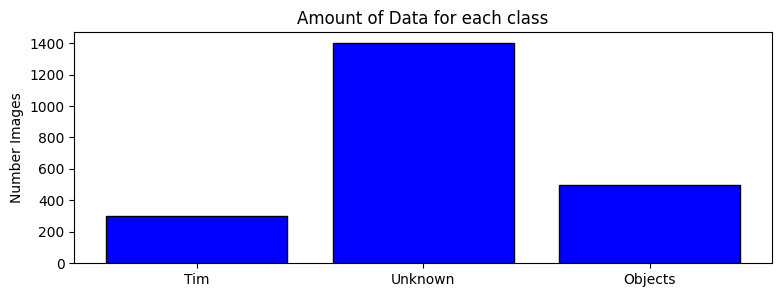

In [5]:
# Create a list of class names
names = ['Tim', 'Unknown', 'Objects']

# Create a list of the number of images in each class
values = [len(data_tim), len(data_unknown), len(data_objects)]

plt.figure(figsize=(9, 3)) # Set up the figure size for the bar chart
plt.bar(names, values, color='blue', edgecolor='black') # Create a bar chart with the class names as x-axis labels and the values as bar heights
plt.ylabel('Number Images') # Set the label for the y-axis
plt.title('Amount of Data for each class') # Set the title
plt.show() # Display the chart

## Resizing the Images

The images are now correctly loaded as PIL images and can be further processed. The standart format for images using neural networks is 224x224 pixel. Therefore the images get resized. Due to the resizing process the aspect ratio of the images is getting changed which results in a weak augmentation.

In [9]:
### Resizing the image of both classes
# Create an empty list to store the resized images for the 'Tim' class
images_tim = []

# Iterate over each JPEG file in the './data/Tim/' directory
for filename in glob.glob("./data/Tim/" + "*.jpg"):

    # Open the image file using PIL's Image module
    im = Image.open(filename)
    # Perform any necessary image orientation adjustment using ImageOps.exif_transpose
    # This is need because the image are sometimes roted while saving
    im = ImageOps.exif_transpose(im)
    # Resize the image to a target size of 224x224 pixels
    resized_im = im.resize([224, 224])
    # Append the resized image to the 'images_tim' list
    images_tim.append(resized_im)

# Print the number of resized images for the 'Tim' class
print("Tim list:", len(images_tim))
# Print the first resized image in the 'images_tim' list
print(images_tim[0])


# Create an empty list to store the resized images for the 'Unknown' class
images_unknown = []

# Iterate over each JPEG file in the './data/Unknown/' directory
for filename in glob.glob("./data/Unknown/" + "*.jpg"):

    # Open the image file using PIL's Image module
    im = Image.open(filename)
    # Perform any necessary image orientation adjustment using ImageOps.exif_transpose
    # This is need because the image are sometimes roted while saving
    im = ImageOps.exif_transpose(im)
    # Resize the image to a target size of 224x224 pixels
    resized_im = im.resize([224, 224])
    # Append the resized image to the 'images_unknown' list
    images_unknown.append(resized_im)


# Print the number of resized images for the 'Unknown' class
print("Unknown list:", len(images_unknown))
# Print the first resized image in the 'images_unknown' list
print(images_unknown[0])


# Create an empty list to store the resized images for the 'Object' class
images_objects = []

# Iterate over each JPEG file in the './data/Objects/' directory
for filename in glob.glob("./data/Objects/" + "*.jpg"):

    # Open the image file using PIL's Image module
    im = Image.open(filename)
    # Perform any necessary image orientation adjustment using ImageOps.exif_transpose
    # This is need because the image are sometimes roted while saving
    im = ImageOps.exif_transpose(im)
    # Resize the image to a target size of 224x224 pixels
    resized_im = im.resize([224, 224])
    # Append the resized image to the 'images_objects' list
    images_objects.append(resized_im)


# Print the number of resized images for the 'Objects' class
print("Object list:", len(images_objects))
# Print the first resized image in the 'images_objects' list
print(images_objects[0])

Tim list: 300
<PIL.Image.Image image mode=RGB size=224x224 at 0x7D91B69E1E10>
Unknown list: 1399
<PIL.Image.Image image mode=RGB size=224x224 at 0x7D91B5B9F040>
Object list: 495
<PIL.Image.Image image mode=RGB size=224x224 at 0x7D91181C8070>


## Print different pictures from each class

In [10]:
def printImages(images):
    for i in range(0,6,3):
        # Create a figure and axes
        fig, ax = plt.subplots(1,3, figsize=(8, 4))

        # Display the image
        ax[0].imshow(images[i])
        ax[1].imshow(images[i+5+1])
        ax[2].imshow(images[i+10+2])

        # Add a legend
        legend_text = ""
        ax[0].text(10, 10, legend_text, color='white', backgroundcolor='black')
        ax[1].text(10, 10, legend_text, color='white', backgroundcolor='black')
        ax[2].text(10, 10, legend_text, color='white', backgroundcolor='black')
        # ax[2].text(10, 10, legend_text, color='white', backgroundcolor='black')

        # Remove the axis labels
        ax[0].axis("off")
        ax[1].axis("off")
        ax[2].axis("off")

        # Adjust the layout
        plt.tight_layout()

        # Show the plot
        plt.show()

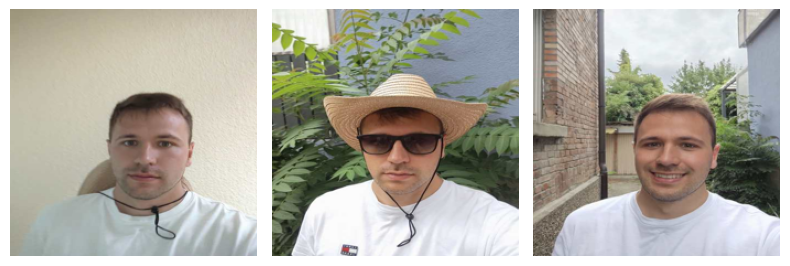

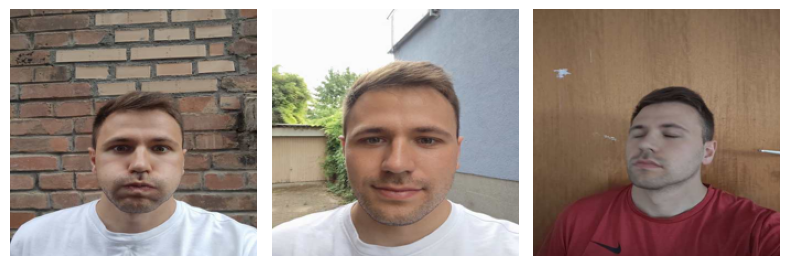

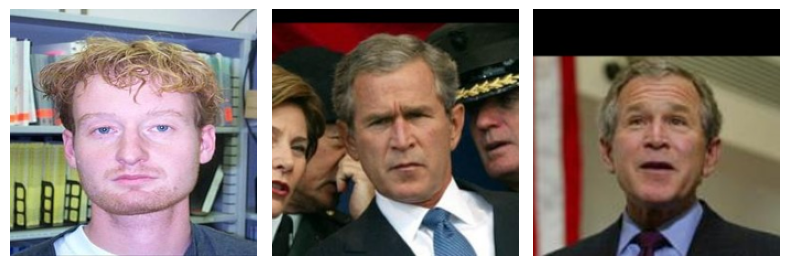

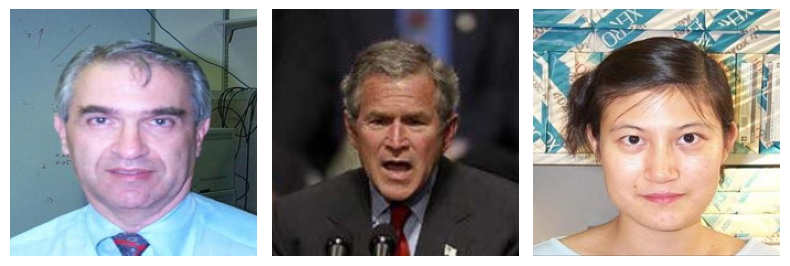

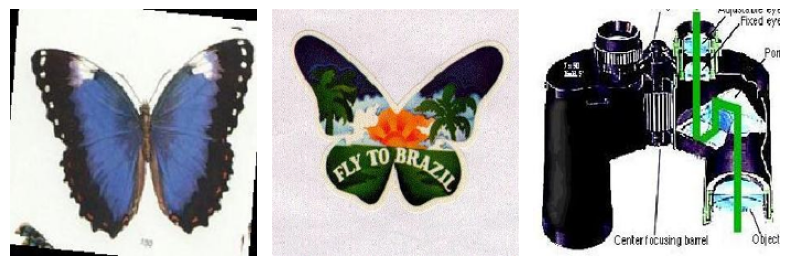

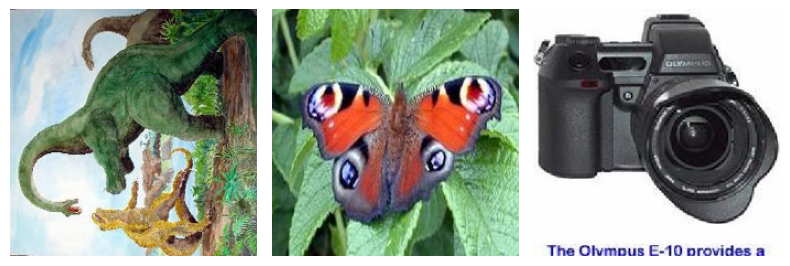

In [11]:
printImages(images_tim)
printImages(images_unknown)
printImages(images_objects)

## Normalize images
Due to the normalization of the images the the training can get more effectiv and robust. The images get converted into arrays, then get normalized and afterwards converted back into PIL images written in a class specific list.

In [12]:
# Create an empty list to store the normalized images for the 'Tim' class
images_tim_norm = []

# Iterate over each resized image in the 'images_tim' list
for i in range(len(images_tim)):
    # Convert the resized image to an array
    temp_data = img_to_array(images_tim[i])
    # Normalize the image array using cv2.normalize, scaling the values between 0 and 1
    img_norm = cv2.normalize(temp_data, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    # Convert the normalized array back to an image and append it to the 'images_tim_norm' list
    images_tim_norm.append(array_to_img(img_norm))

# Print the number of normalized images for the 'Tim' class
print("Tim normalized list:", len(images_tim_norm))
# Print the first normalized image in the 'images_tim_norm' list
print(images_tim_norm[0])


# Create an empty list to store the normalized images for the 'Unknown' class
images_unknown_norm = []

# Iterate over each resized image in the 'images_unknown' list
for i in range(len(images_unknown)):
    # Convert the resized image to an array
    temp_data = img_to_array(images_unknown[i])
    # Normalize the image array using cv2.normalize, scaling the values between 0 and 1
    img_norm = cv2.normalize(temp_data, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    # Convert the normalized array back to an image and append it to the 'images_unknown_norm' list
    images_unknown_norm.append(array_to_img(img_norm))

# Print the number of normalized images for the 'Unknown' class
print("Unknown normalized list:", len(images_unknown_norm))
# Print the first normalized image in the 'images_unknown_norm' list
print(images_unknown_norm[0])


# Create an empty list to store the normalized images for the 'Unknown' class
images_objects_norm = []

# Iterate over each resized image in the 'images_unknown' list
for i in range(len(images_objects)):
    # Convert the resized image to an array
    temp_data = img_to_array(images_objects[i])
    # Normalize the image array using cv2.normalize, scaling the values between 0 and 1
    img_norm = cv2.normalize(temp_data, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    # Ensure the image has 3 dimensions (add channel dimension if necessary)
    if img_norm.ndim == 2:
        img_norm = np.expand_dims(img_norm, axis=-1)  # Add channel dimension
    # Convert the normalized array back to an image and append it to the 'images_objects_norm' list
    images_objects_norm.append(array_to_img(img_norm))

# Print the number of normalized images for the 'Objects' class
print("Objects normalized list:", len(images_objects_norm))
# Print the first normalized image in the 'images_objects_norm' list
print(images_objects_norm[0])

Tim normalized list: 300
<PIL.Image.Image image mode=RGB size=224x224 at 0x7D910C4E7850>
Unknown normalized list: 1399
<PIL.Image.Image image mode=RGB size=224x224 at 0x7D910C4E7880>
Objects normalized list: 495
<PIL.Image.Image image mode=RGB size=224x224 at 0x7D910C4E4B20>


# Labeling and Splitting the data
The following code creates label lists for the different image classes. Afterwards the data gets split into training, validation and testing data. The Split is made that 70% is training data and the remaining 30% get divided in 15% validation and testing data.

In [13]:
# Create labels for each class
y_tim = []
y_unknown = []
y_objects = []

# Append the label 'tim' to the label list to provide a label for each image
for i in range(len(images_tim_norm)):
    y_tim.append('tim')

# Append the label 'unknown' to the label list to provide a label for each image
for i in range(len(images_unknown_norm)):
    y_unknown.append('unknown')

# Append the label 'unknown' to the label list to provide a label for each image
for i in range(len(images_objects_norm)):
    y_objects.append('objects')

# Split each class into training data. The rest is used for validation and testing
X_train_tim, X_rest_tim, y_train_tim, y_rest_tim = train_test_split(images_tim_norm, y_tim, train_size=0.7)
X_train_unknown, X_rest_unknown, y_train_unknown, y_rest_unknown = train_test_split(images_unknown_norm, y_unknown, train_size=0.7)
X_train_objects, X_rest_objects, y_train_objects, y_rest_objects = train_test_split(images_objects_norm, y_objects, train_size=0.7)

# Split the rest data into of each class into validation and test data
X_valid_tim, X_test_tim, y_valid_tim, y_test_tim = train_test_split(X_rest_tim, y_rest_tim, test_size=0.5)
X_valid_unknown, X_test_unknown, y_valid_unknown, y_test_unknown = train_test_split(X_rest_unknown, y_rest_unknown, test_size=0.5)
X_valid_objects, X_test_objects, y_valid_objects, y_test_objects = train_test_split(X_rest_objects, y_rest_objects, test_size=0.5)

## Vizualize the data split

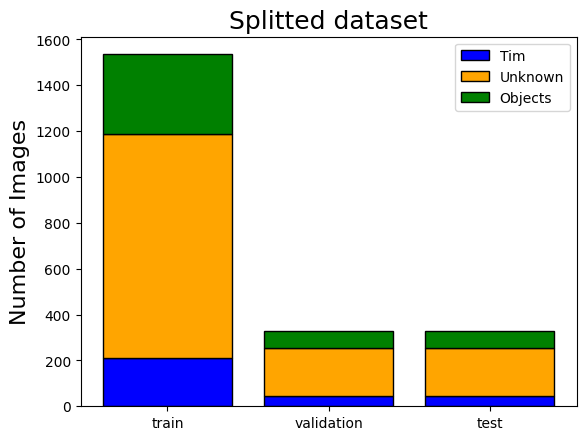

In [14]:
# Define the splits and data origins
split = ['train', 'validation', 'test']
data_origin = ['Tim', 'Unknown', 'Objects']

# Create an array of positions for the bars
pos = np.arange(len(split))

# Create lists of values for the 'Tim' class for each split
values_tim = [len(X_train_tim), len(X_valid_tim), len(X_test_tim)]
# Create lists of values for the 'unknown' class for each split
values_unknown = [len(X_train_unknown), len(X_valid_unknown), len(X_test_unknown)]
# Create lists of values for the 'ojects' class for each split
values_objects = [len(X_train_objects), len(X_valid_objects), len(X_test_objects)]

# Create a bar plot for the 'Tim' class
plt.bar(pos, values_tim, color='blue', edgecolor='black')
# Create a bar plot for the 'unknown' class, stacking on top of the 'Tim' class
plt.bar(pos, values_unknown, color='orange', edgecolor='black', bottom=values_tim)
# Create a bar plot for the 'Objects' class, stacking on top of the 'Unknown' class
plt.bar(pos, values_objects, color='green', edgecolor='black', bottom=[values_tim[i] + values_unknown[i] for i in range(len(pos))], label='Objects')

# Set the x-axis ticks to the split names
plt.xticks(pos, split)
# Set the y-axis label
plt.ylabel('Number of Images', fontsize=16)
# Set the title of the plot
plt.title('Splitted dataset', fontsize=18)
# Add a legend to differentiate the data origins
plt.legend(data_origin)
# Display the plot
plt.show()

## Save the split data
The data gets stored in the presented folder structure from Chapter 'Creation of the dataset':
```
- data
    |-train
        |- Tim
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
        |- Unknown
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
        |- Objects
            |- image_0.jpeg
            |- image_1.jpeg
            |- image_2.jpeg
            |- ...
    |-validation
    .
    .
    .
    |-test
    .
    .
    .
```
To make sure the folder structure does exist it gets checked beforehand.

In [15]:
# Create the necessary directories if they don't exist
import os
os.makedirs('data/train/tim', exist_ok=True)
os.makedirs('data/validation/tim', exist_ok=True)
os.makedirs('data/test/tim', exist_ok=True)
os.makedirs('data/train/unknown', exist_ok=True)
os.makedirs('data/validation/unknown', exist_ok=True)
os.makedirs('data/test/unknown', exist_ok=True)
os.makedirs('data/train/objects', exist_ok=True)
os.makedirs('data/validation/objects', exist_ok=True)
os.makedirs('data/test/objects', exist_ok=True)

# Save the 'Tim' class training images
for i in range(len(X_train_tim)):
    X_train_tim[i].save(r'data/train/tim/image_' + str(i) + '.jpg', 'JPEG')

# Save the 'Tim' class validation images
for i in range(len(X_valid_tim)):
    X_valid_tim[i].save(r'data/validation/tim/image_' + str(i) + '.jpg', 'JPEG')

# Save the 'Tim' class test images
for i in range(len(X_test_tim)):
    X_test_tim[i].save(r'data/test/tim/image_' + str(i) + '.jpg', 'JPEG')



# Save the 'Unknown' class training images
for i in range(len(X_train_unknown)):
    X_train_unknown[i].save(r'data/train/unknown/image_' + str(i) + '.jpg', 'JPEG')

# Save the 'Unknown' class validation images
for i in range(len(X_valid_unknown)):
    X_valid_unknown[i].save(r'data/validation/unknown/image_' + str(i) + '.jpg', 'JPEG')

# Save the 'Unknown' class test images
for i in range(len(X_test_unknown)):
    X_test_unknown[i].save(r'data/test/unknown/image_' + str(i) + '.jpg', 'JPEG')



# Save the 'Objects' class training images
for i in range(len(X_train_objects)):
    X_train_objects[i].save(r'data/train/objects/image_' + str(i) + '.jpg', 'JPEG')

# Save the 'Objects' class validation images
for i in range(len(X_valid_objects)):
    X_valid_objects[i].save(r'data/validation/objects/image_' + str(i) + '.jpg', 'JPEG')

# Save the 'Objects' class test images
for i in range(len(X_test_objects)):
    X_test_objects[i].save(r'data/test/objects/image_' + str(i) + '.jpg', 'JPEG')

# Data Augmentation
Although the pictures from the class Tim are alraedy a little bit augmented through the resizing process, in this part all the images classes get additional augmented images added. The data augmentation helps to build up a bigger data set but more important makes the training process ay more robust. The transformations apllied through the augmentaion helps generalizing the model and reduce overfitting. On the other hand when the augmentation is to striong, the images can get unrealistic which will decrease the performance of the model.

In [16]:
# Convert images to arrays and expand dimensions for the 'Tim' class training and validation sets
train_tim_array = []
for i in range(len(X_train_tim)):
    train_tim_array.append(np.expand_dims(img_to_array(X_train_tim[i]), axis=0))

valid_tim_array = []
for i in range(len(X_valid_tim)):
    valid_tim_array.append(np.expand_dims(img_to_array(X_valid_tim[i]), axis=0))

# Convert images to arrays and expand dimensions for the 'Unknown' class training and validation sets
train_unknown_array = []
for i in range(len(X_train_unknown)):
    train_unknown_array.append(np.expand_dims(img_to_array(X_train_unknown[i]), axis=0))

valid_unknown_array = []
for i in range(len(X_valid_unknown)):
    valid_unknown_array.append(np.expand_dims(img_to_array(X_valid_unknown[i]), axis=0))

# Convert images to arrays and expand dimensions for the 'Objects' class training and validation sets
train_objects_array = []
for i in range(len(X_train_objects)):
    train_objects_array.append(np.expand_dims(img_to_array(X_train_objects[i]), axis=0))

valid_objects_array = []
for i in range(len(X_valid_objects)):
  valid_objects_array.append(np.expand_dims(img_to_array(X_valid_objects[i]), axis=0))

The ImageDataGenerator() is a Tool from Tensorflow to create augmented images. The function is capable of transforming the images during traing but in this case we want to have a look at the augmented images. Therefore we need to aply this function before training.

In [17]:
# Data augmentation parameters
rotation_range = 35
width_shift_range = 0.2
height_shift_range = 0.2
zoom_range = 0.2
brightness_range = [0.2, 1.4]
fill_mode = 'reflect'

# Data augmentation for the 'Unknown' class training and validation sets
datagen = ImageDataGenerator(width_shift_range=width_shift_range, height_shift_range=height_shift_range, vertical_flip=False, horizontal_flip=True, rotation_range=rotation_range, brightness_range=brightness_range, zoom_range=zoom_range, fill_mode=fill_mode)

## Apply Augmentation

In [18]:
images_train_aug_tim = []
images_val_aug_tim = []
images_train_aug_unknown = []
images_val_aug_unknown = []
images_train_aug_objects = []
images_val_aug_objects = []

# Generate augmented images for the 'Tim' class training set
for n in range(2):
    for i in range(len(train_tim_array)):
        train_generator_tim = datagen.flow(train_tim_array[i], batch_size=1)
        # Generate a batch of augmented images
        batch = train_generator_tim.next()
        # normalize the generated images
        img_norm = cv2.normalize(batch[0], None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
        im = array_to_img(img_norm)
        images_train_aug_tim.append(im)
        # save the augmented images in the same folder as the original images of the Tim class
        im.save(r'data/train/tim/augmented_image_' + str(i)+'_'+ str(n) + '.jpg')

# Generate augmented images for the 'Tim' class validation set

for i in range(len(valid_tim_array)):
    valid_generator_tim = datagen.flow(valid_tim_array[i], batch_size=1)
    # Generate a batch of augmented images
    batch = valid_generator_tim.next()
    # normalize the generated images
    img_norm = cv2.normalize(batch[0], None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    im = array_to_img(img_norm)
    images_val_aug_tim.append(im)
    # save the augmented images in the same folder as the original images of the Tim class
    im.save(r'data/validation/tim/augmented_image_' + str(i)+ '.jpg')

# Generate augmented images for the 'Unknown' class training set
for n in range(2):
    for i in range(len(train_unknown_array)):
        train_generator_unknown = datagen.flow(train_unknown_array[i], batch_size=1)
        # Generate a batch of augmented images
        batch = train_generator_unknown.next()
        # normalize the generated images
        img_norm = cv2.normalize(batch[0], None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
        im = array_to_img(img_norm)
        images_train_aug_unknown.append(im)
        # save the augmented images in the same folder as the original images of the unknown class
        im.save(r'data/train/unknown/augmented_image_' + str(i)+'_'+ str(n) + '.jpg')

# Generate augmented images for the 'Unknown' class validation set

for i in range(len(valid_unknown_array)):
    valid_generator_unknown = datagen.flow(valid_unknown_array[i], batch_size=1)
    # Generate a batch of augmented images
    batch = valid_generator_unknown.next()
    # normalize the generated images
    img_norm = cv2.normalize(batch[0], None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    im = array_to_img(img_norm)
    images_val_aug_unknown.append(im)
    # save the augmented images in the same folder as the original images of the unknown class
    im.save(r'data/validation/unknown/augmented_image_' + str(i)+ '.jpg')

# Generate augmented images for the 'Objects' class training set
for n in range(2):
    for i in range(len(train_objects_array)):
        train_generator_objects = datagen.flow(train_objects_array[i], batch_size=1)
        # Generate a batch of augmented images
        batch = train_generator_objects.next()
        # normalize the generated images
        img_norm = cv2.normalize(batch[0], None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
        # Ensure the image has 3 dimensions (add channel dimension if necessary)
        if img_norm.ndim == 2:
          img_norm = np.expand_dims(img_norm, axis=-1)  # Add channel dimension
        im = array_to_img(img_norm)
        images_train_aug_objects.append(im)
        # save the augmented images in the same folder as the original images of the unknown class
        im.save(r'data/train/objects/augmented_image_' + str(i)+'_'+ str(n) + '.jpg')

# Generate augmented images for the 'Objects' class validation set

for i in range(len(valid_objects_array)):
    valid_generator_objects = datagen.flow(valid_objects_array[i], batch_size=1)
    # Generate a batch of augmented images
    batch = valid_generator_objects.next()
    # normalize the generated images
    img_norm = cv2.normalize(batch[0], None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    # Ensure the image has 3 dimensions (add channel dimension if necessary)
    if img_norm.ndim == 2:
        img_norm = np.expand_dims(img_norm, axis=-1)  # Add channel dimension
    im = array_to_img(img_norm)
    images_val_aug_objects.append(im)
    # save the augmented images in the same folder as the original images of the unknown class
    im.save(r'data/validation/objects/augmented_image_' + str(i)+ '.jpg')

## Show augmented Images for each class from training and validation data

Augmented images of the class Tim from the training data: 


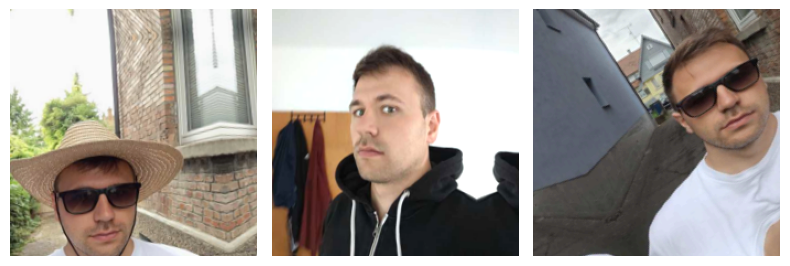

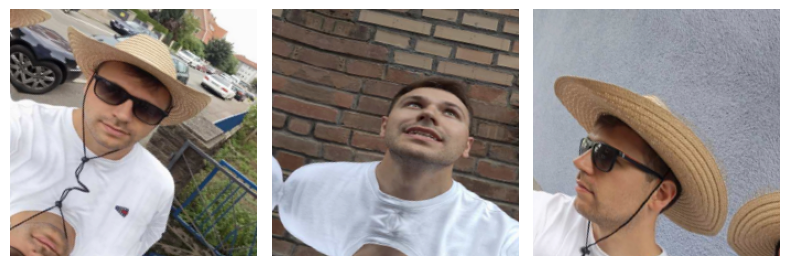

In [19]:
# Print augmented Images of the class Tim from the training data
print("Augmented images of the class Tim from the training data: ")
printImages(images_train_aug_tim)

Augmented images of the class Tim from the validation data: 


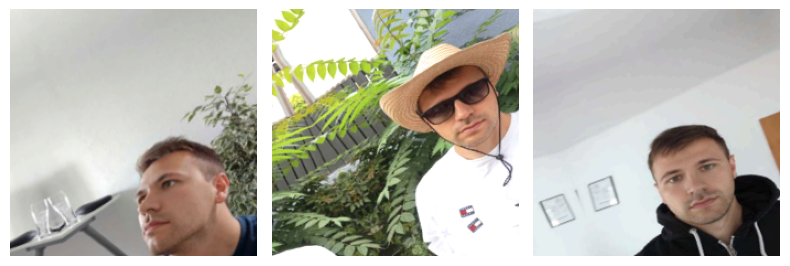

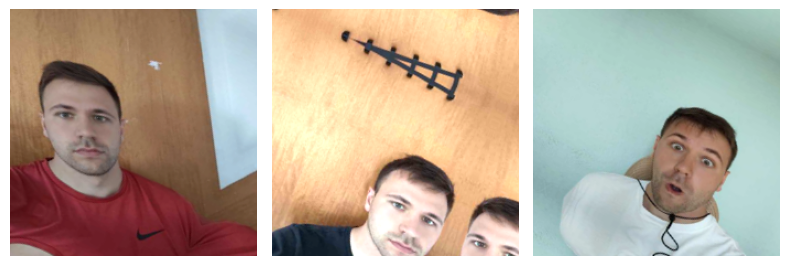

In [20]:

# Print augmented Images of the class Tim from the training data
print("Augmented images of the class Tim from the validation data: ")
printImages(images_val_aug_tim)

Augmented images of the class unknown from the training data: 


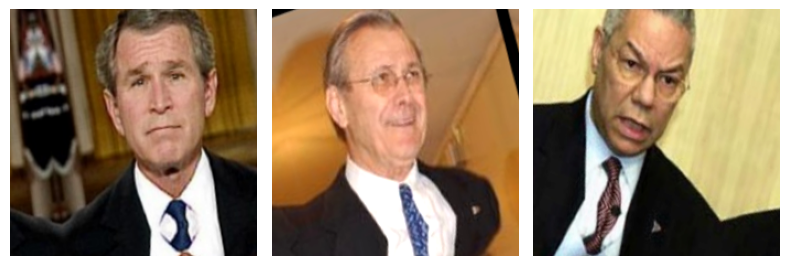

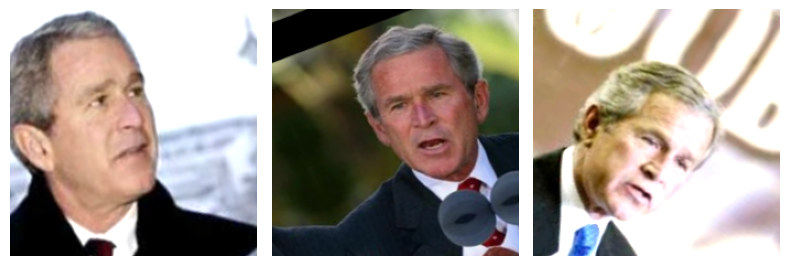

In [21]:
# Print augmented Images of the class Unknown from the training data
print("Augmented images of the class unknown from the training data: ")
printImages(images_train_aug_unknown)

Augmented images of the class Unknwon from the validation data: 


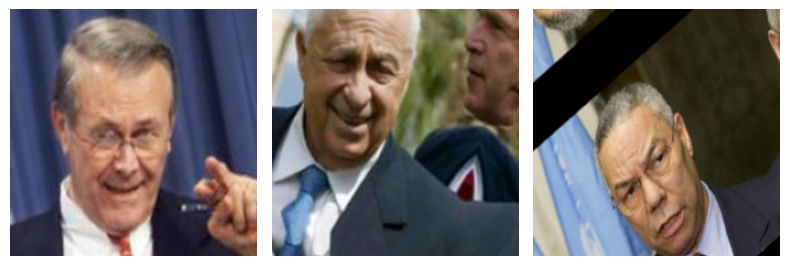

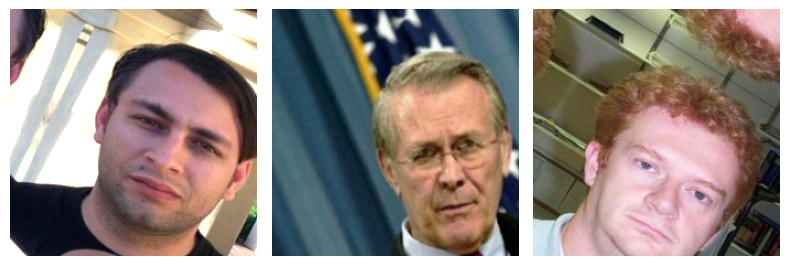

In [22]:
# Print augmented Images of the class Unknown from the validation data
print("Augmented images of the class Unknwon from the validation data: ")
printImages(images_val_aug_unknown)

Augmented images of the class Objects from the training data: 


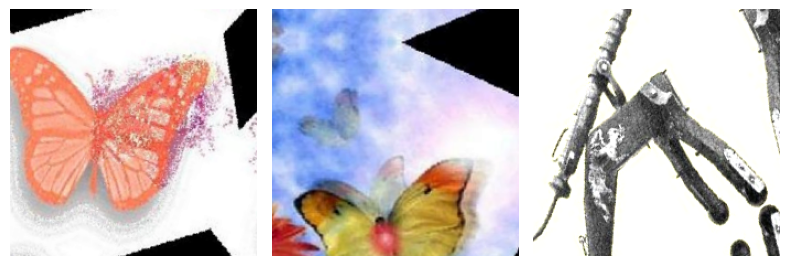

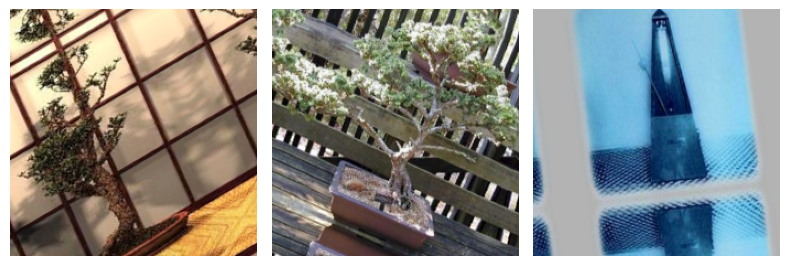

In [23]:
# Print augmented Images of the class Objects from the training data
print("Augmented images of the class Objects from the training data: ")
printImages(images_train_aug_objects)

Augmented images of the class Objects from the validation data: 


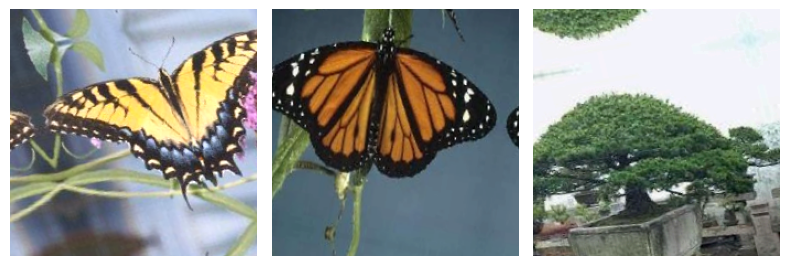

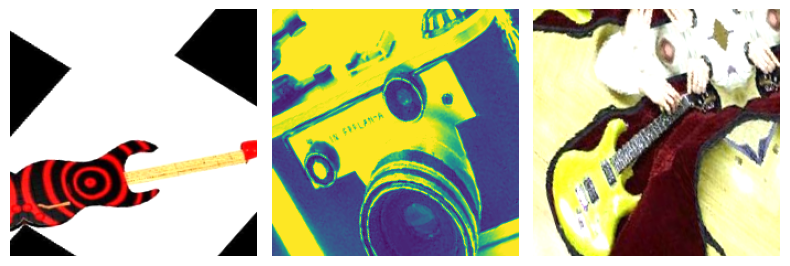

In [24]:
# Print augmented Images of the class Objects from the validation data
print("Augmented images of the class Objects from the validation data: ")
printImages(images_val_aug_objects)

## Show the Split between the original data and the augmented data

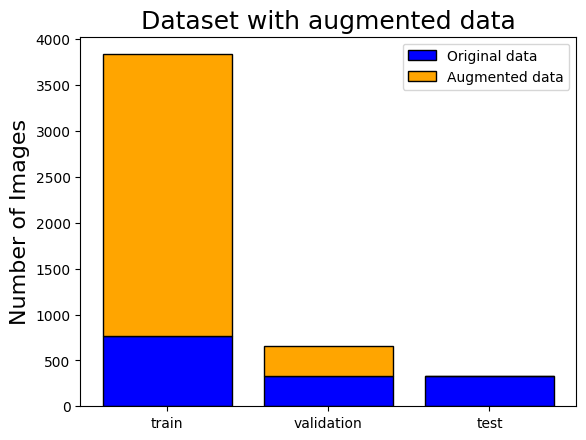

In [25]:
# Define the splits and data origins for the plot
split = ['train', 'validation', 'test']
data_origin = ['Original data', 'Augmented data']

# Create an array of positions based on the number of splits
pos = np.arange(len(split))

# Prepare the values for the 'Original data' bars
values_og = [len(train_tim_array+train_tim_array+train_objects_array), len(valid_tim_array+valid_unknown_array+valid_objects_array), len(X_test_unknown+X_test_tim+X_test_objects)]

# Prepare the values for the 'Augmented data' bars
values_augmented = [len(images_train_aug_tim+images_train_aug_unknown+images_train_aug_objects), len(images_val_aug_tim+images_val_aug_unknown+images_val_aug_objects), 0]

# Plotting the bar chart
plt.bar(pos, values_og, color='blue', edgecolor='black')
plt.bar(pos, values_augmented, color='orange', edgecolor='black', bottom=values_og)
plt.xticks(pos, split)
plt.ylabel('Number of Images', fontsize=16)
plt.title('Dataset with augmented data', fontsize=18)
plt.legend(data_origin)
plt.show()

# Prelearned Models

The data preprocessing is now done and we have to decide which moedel we want to use. In order to find a fitting model for a task you have to make yourself clear what the goal of the trained modell will be. In our case we want a high Top-1 accuracy to decide which of our three classes is most likely present in the presented image. Therefore the ResNet and the Inception Architecturs seem to have a good compromise bettwen Top-1 Accuracy and the number of operation needed (compare with Figure). To compare multiple variantes of modells we will train:
- ResNet-50
- ResNet-101
- ResNet-152
- Inception-V3

![modelle.png](https://drive.google.com/uc?export=view&id=12O-PZuqyA1dRCzRLh_yF_6msHdEIWaYF)

(Figures copyright Alfredo Canziani, Adam Paszke, Eugenio Culurciello, 2017)

## Set model parameters
For the input parameters the input image size is set to 224x24 pixels. Because we want to execute transferlearning we predefine the weight through the imagenet weights. To reduce the risk of overfitting we use a dropout rate of 0.5 what deactivates 50% of the neurons in each training step randomly. to ensure that we do not demand unnecessary resources we introduce an early stopping on the validation loss of 4.

In [26]:
# Define the input shape for the model
input_shape = (224, 224, 3)

# Specify the weights to be used with 'imagenet'
weights = 'imagenet'

dropout_rate = 0.5  # Adjust the dropout rate as desired

# Configure Early Stopping callback
patience = 4  # Number of epochs with no improvement after which training will be stopped
early_stopping = EarlyStopping(monitor='val_loss', patience=patience)

## ResNet50
Creating the ResNet50 model from the tensorflow.keras library, using the model parameters from above and add the dropout layer and the 3 Output classesin the last fully conected (Dense) layer.

In [31]:
# Create a base model using ResNet50 architecture
ResNet50_base_model = ResNet50(include_top=False, input_shape=input_shape, weights=weights)

# Freeze the layers of the base model
for layer in ResNet50_base_model.layers:
    layer.trainable = False

# Create a model for the Adam optimizer and one for the RMSprop optimizer.
# Add a classification head on top of the base model
ResNet50_model_adam = tf.keras.Sequential([
    ResNet50_base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    Dropout(dropout_rate),  # Add Dropout layer with the specified rate
    tf.keras.layers.Dense(3, activation='softmax')
])

# Generiere die Summary für das Modell mit Adam Optimizer
print("ResNet50_model_adam Summary:")
ResNet50_model_adam.summary()
print("--------------------------------------------------------------------------")
# Add a classification head on top of the base model
ResNet50_model_rmsprop = tf.keras.Sequential([
    ResNet50_base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    Dropout(dropout_rate),  # Add Dropout layer with the specified rate
    tf.keras.layers.Dense(3, activation='softmax')
])
# Generiere die Summary für das Modell mit Adam Optimizer
print("ResNet50_model_rmsprop Summary:")
ResNet50_model_rmsprop.summary()

ResNet50_model_adam Summary:
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 global_average_pooling2d_8  (None, 2048)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dropout_8 (Dropout)         (None, 2048)              0         
                                                                 
 dense_8 (Dense)             (None, 3)                 6147      
                                                                 
Total params: 23593859 (90.00 MB)
Trainable params: 6147 (24.01 KB)
Non-trainable params: 23587712 (89.98 MB)
_________________________________________________________________
-----------------------------------------------

## ResNet101
Creating the ResNet101 model from the tensorflow.keras library, using the model parameters from above and add the dropout layer and the 3 Output classesin the last fully conected (Dense) layer.

In [32]:
# Create the ResNet101 model
ResNet101_base_model = ResNet101(include_top=False, input_shape=input_shape, weights=weights)

# Freeze the layers of the base model
for layer in ResNet101_base_model.layers:
    layer.trainable = False

# Create a model for the Adam optimizer and one for the RMSprop optimizer.
# Add a classification head on top of the base model
ResNet101_model_adam = tf.keras.Sequential([
    ResNet101_base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    Dropout(dropout_rate),  # Add Dropout layer with the specified rate
    tf.keras.layers.Dense(3, activation='softmax')
])

# Generiere die Summary für das Modell mit Adam Optimizer
print("ResNet101_model_adam Summary:")
ResNet101_model_adam.summary()
print("--------------------------------------------------------------------------")

# Add a classification head on top of the base model
ResNet101_model_rmsprop = tf.keras.Sequential([
    ResNet101_base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    Dropout(dropout_rate),  # Add Dropout layer with the specified rate
    tf.keras.layers.Dense(3, activation='softmax')
])

# Generiere die Summary für das Modell mit Adam Optimizer
print("ResNet101_model_adam Summary:")
ResNet101_model_rmsprop.summary()

171446536/171446536 [==============================] - 9s 0us/step
ResNet101_model_adam Summary:
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 7, 7, 2048)        42658176  
                                                                 
 global_average_pooling2d_1  (None, 2048)              0         
 0 (GlobalAveragePooling2D)                                      
                                                                 
 dropout_10 (Dropout)        (None, 2048)              0         
                                                                 
 dense_10 (Dense)            (None, 3)                 6147      
                                                                 
Total params: 42664323 (162.75 MB)
Trainable params: 6147 (24.01 KB)
Non-trainable params: 42658176 (162.73 MB)
__________________________________________

## ResNet152
Creating the ResNet152 model from the tensorflow.keras library, using the model parameters from above and add the dropout layer and the 3 Output classesin the last fully conected (Dense) layer.

In [33]:
# Create the ResNet152 model
ResNet152_base_model = ResNet152(include_top=False, input_shape=input_shape, weights=weights)

# Freeze the layers of the base model
for layer in ResNet152_base_model.layers:
    layer.trainable = False

# Create a model for the Adam optimizer and one for the RMSprop optimizer.
# Add a classification head on top of the base model
ResNet152_model_adam = tf.keras.Sequential([
    ResNet152_base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    Dropout(dropout_rate),  # Add Dropout layer with the specified rate
    tf.keras.layers.Dense(3, activation='softmax')
])

# Generiere die Summary für das Modell mit Adam Optimizer
print("ResNet152_model_adam Summary:")
ResNet152_model_adam.summary()
print("--------------------------------------------------------------------------")

# Add a classification head on top of the base model
ResNet152_model_rmsprop = tf.keras.Sequential([
    ResNet152_base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    Dropout(dropout_rate),  # Add Dropout layer with the specified rate
    tf.keras.layers.Dense(3, activation='softmax')
])

# Generiere die Summary für das Modell mit Adam Optimizer
print("ResNet152_model_rmsprop Summary:")
ResNet152_model_rmsprop.summary()

234698864/234698864 [==============================] - 12s 0us/step
ResNet152_model_adam Summary:
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet152 (Functional)      (None, 7, 7, 2048)        58370944  
                                                                 
 global_average_pooling2d_1  (None, 2048)              0         
 2 (GlobalAveragePooling2D)                                      
                                                                 
 dropout_12 (Dropout)        (None, 2048)              0         
                                                                 
 dense_12 (Dense)            (None, 3)                 6147      
                                                                 
Total params: 58377091 (222.69 MB)
Trainable params: 6147 (24.01 KB)
Non-trainable params: 58370944 (222.67 MB)
_________________________________________

## Inception-V3
Creating the Inception V3 model from the tensorflow.keras library, using the model parameters from above and add the dropout layer and the 3 Output classesin the last fully conected (Dense) layer.

In [34]:
# Create the InceptionV3 model
InceptionV3_base_model = InceptionV3(include_top=False, input_shape=input_shape, weights=weights)

# Freeze the layers of the base model
for layer in InceptionV3_base_model.layers:
    layer.trainable = False

# Create a model for the Adam optimizer and one for the RMSprop optimizer.
# Add a classification head on top of the base model
InceptionV3_model_adam = tf.keras.Sequential([
    InceptionV3_base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    Dropout(dropout_rate),  # Add Dropout layer with the specified rate
    tf.keras.layers.Dense(3, activation='softmax')
])

# Generiere die Summary für das Modell mit Adam Optimizer
print("InceptionV3_model_adam Summary:")
InceptionV3_model_adam.summary()
print("--------------------------------------------------------------------------")

# Add a classification head on top of the base model
InceptionV3_model_rmsprop = tf.keras.Sequential([
    InceptionV3_base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    Dropout(dropout_rate),  # Add Dropout layer with the specified rate
    tf.keras.layers.Dense(3, activation='softmax')
])

# Generiere die Summary für das Modell mit Adam Optimizer
print("InceptionV3_model_adam Summary:")
InceptionV3_model_rmsprop.summary()

87910968/87910968 [==============================] - 5s 0us/step
InceptionV3_model_adam Summary:
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 5, 5, 2048)        21802784  
                                                                 
 global_average_pooling2d_1  (None, 2048)              0         
 4 (GlobalAveragePooling2D)                                      
                                                                 
 dropout_14 (Dropout)        (None, 2048)              0         
                                                                 
 dense_14 (Dense)            (None, 3)                 6147      
                                                                 
Total params: 21808931 (83.19 MB)
Trainable params: 6147 (24.01 KB)
Non-trainable params: 21802784 (83.17 MB)
____________________________________________

# Training
Now that the models are initialize we can get to nex step of training them. For the Training process ImageDataGenerator's are needed. As mentioned before the augmentation can be doene during the training when the ImageDataGenerator receives additional arguments. In our case we have already augmented our images so the comented parameters in the Generator are just for illustration purposes.

In [35]:
# if you want more augmented data you can uncomment the parameters in the ImageDataGenerator
train_datagen = ImageDataGenerator(
    # rotation_range=20,
    # width_shift_range=0.2,
    # height_shift_range=0.2,
    # shear_range=0.2,
    # zoom_range=0.2,
    # horizontal_flip=True
)

validation_datagen = ImageDataGenerator()

## Create the data generators
In this part the data generators for training and validation are implemented. We use a batch size of 32 which is a common value. Additionaly we define our input size of the images and ste the class mode to 'categorial' which means the data gets one-hot encoded. The on-hot encoded data can e efficently be handleed due to the softmax activation function the the dense layer of our models.

In [36]:
# Create data generators for training and validation data

# Specify the directories containing the training and validation data
train_dir = '/content/data/train/'
val_dir = '/content/data/validation/'

# Set the batch size for each iteration during training
batch_size = 32

# Define the desired size for input images
IMAGE_SIZE = (224, 224)

class_mode='categorical'


# Create a data generator for training data
train_generator = train_datagen.flow_from_directory(
    directory = train_dir,                            # Directory containing the training data
    batch_size=batch_size,                # Number of samples per batch
    target_size=IMAGE_SIZE,               # Resize input images to the specified size
    shuffle=True,                         # Shuffle the order of images during training
    class_mode=class_mode                 # Generate one-hot encoded labels for multi-class classification
)

# Create a data generator for validation data
validation_generator = validation_datagen.flow_from_directory(
    val_dir,                              # Directory containing the validation data
    batch_size=batch_size,                # Number of samples per batch
    target_size=IMAGE_SIZE,               # Resize input images to the specified size
    shuffle=True,                         # Shuffle the order of images during validation
    class_mode=class_mode                 # Generate one-hot encoded labels for multi-class classification
)

Found 4605 images belonging to 3 classes.
Found 658 images belonging to 3 classes.


## Compile the models
This section ompiles our created models and define the optimizers used aswell as the loss functiona and the metrics to evaluate the training process. We use the adam and the RMSprop optimizer. Both of them are using adaptive learning rates for each weight and use a moving average of squared gradients. Adam can converge faster and is suitable for large datasets and complex models, while RMSprop is robust to widely varying gradient values. Overall it is hard to say which optimzer fits better to the modell, therfore I decided to test both of them for each model.

In [37]:
# Compile the models
# Set the optimizer, loss function, and metrics for evaluation
optimizer_rms = 'rmsprop'
optimizer_adam = 'adam'
loss = 'categorical_crossentropy'
metrics = ['accuracy']

# Compile each model with the adam/rmsprop optimizer, loss, and metrics
ResNet50_model_adam.compile(optimizer=optimizer_adam, loss=loss, metrics=metrics)
ResNet101_model_adam.compile(optimizer=optimizer_adam, loss=loss, metrics=metrics)
ResNet152_model_adam.compile(optimizer=optimizer_adam, loss=loss, metrics=metrics)
InceptionV3_model_adam.compile(optimizer=optimizer_adam, loss=loss, metrics=metrics)

ResNet50_model_rmsprop.compile(optimizer=optimizer_rms, loss=loss, metrics=metrics)
ResNet101_model_rmsprop.compile(optimizer=optimizer_rms, loss=loss, metrics=metrics)
ResNet152_model_rmsprop.compile(optimizer=optimizer_rms, loss=loss, metrics=metrics)
InceptionV3_model_rmsprop.compile(optimizer=optimizer_rms, loss=loss, metrics=metrics)

## Actual Training

Now the actual training takes place. Nearly all Parameters are set already. We only have to define the number of epochs we want to use. A epoch means a full run through the training data. Having a very high number of epochs might result into overfitting because the same pictures are seen over and over again. On the other hand we need a sufficent amount of data to train the models. Beacause we have a good amount of images to train with a epoch of 15 is defined. The steps per epoch is dependent on the batch size, how fast we can go through the training data once.

For the actual training the fit() function is used now. The two previously created data generators are passed to it, as well as the epochs. In addition, the steps_per_epoch and the validation_steps are passed. As last parameter the early_stopping parameter is passed, this was already explained before. With the parameters which are passed, there are no differences between the different models.

The Training can take a wihle because we are using four different models. In my case in Google Colab it took about 30min

In [38]:
# Train the models
# Calculate the total number of validation images
total_val = len(images_val_aug_tim + images_val_aug_unknown + images_val_aug_objects + valid_tim_array + valid_unknown_array + valid_objects_array)

# Set the number of epochs for training
epochs = 15

# Calculate the steps per epoch and validation steps
steps_per_epoch = total_val // batch_size
validation_steps = total_val // batch_size

# Train each model and store the training history
print("#########################################################################")
# ResNet50 model
print('ResNet50 (optimizer: adam):')
history_ResNet50_adam = ResNet50_model_adam.fit(train_generator, epochs=epochs, steps_per_epoch=steps_per_epoch, validation_data=validation_generator, validation_steps=validation_steps, callbacks=[early_stopping])
print('ResNet50 (optimizer: rmsprop):')
history_ResNet50_rmsprop = ResNet50_model_rmsprop.fit(train_generator, epochs=epochs, steps_per_epoch=steps_per_epoch, validation_data=validation_generator, validation_steps=validation_steps, callbacks=[early_stopping])

print("#########################################################################")
# ResNet101 model
print('ResNet101 (optimizer: adam):')
history_ResNet101_adam = ResNet101_model_adam.fit(train_generator, epochs=epochs, steps_per_epoch=steps_per_epoch, validation_data=validation_generator, validation_steps=validation_steps, callbacks=[early_stopping])
print('ResNet101 (optimizer: rmsprop):')
history_ResNet101_rmsprop = ResNet101_model_rmsprop.fit(train_generator, epochs=epochs, steps_per_epoch=steps_per_epoch, validation_data=validation_generator, validation_steps=validation_steps, callbacks=[early_stopping])

print("#########################################################################")
# ResNet152 model
print('ResNet152 (optimizer: adam):')
history_ResNet152_adam = ResNet152_model_adam.fit(train_generator, steps_per_epoch=steps_per_epoch, epochs=epochs, validation_data=validation_generator, validation_steps=validation_steps, callbacks=[early_stopping])
print('ResNet152 (optimizer: rmsprop):')
history_ResNet152_rmsprop = ResNet152_model_rmsprop.fit(train_generator, steps_per_epoch=steps_per_epoch, epochs=epochs, validation_data=validation_generator, validation_steps=validation_steps, callbacks=[early_stopping])

print("#########################################################################")
# InceptionV3 model
print('InceptionV3 (optimizer: adam):')
history_InceptionV3_adam = InceptionV3_model_adam.fit(train_generator, steps_per_epoch=steps_per_epoch, epochs=epochs, validation_data=validation_generator, validation_steps=validation_steps, callbacks=[early_stopping])
print('InceptionV3 (optimizer: rmsprop):')
history_InceptionV3_rmsprop = InceptionV3_model_rmsprop.fit(train_generator, steps_per_epoch=steps_per_epoch, epochs=epochs, validation_data=validation_generator, validation_steps=validation_steps, callbacks=[early_stopping])

#########################################################################
ResNet50 (optimizer: adam):
Epoch 1/15
20/20 [==============================] - 16s 371ms/step - loss: 0.5062 - accuracy: 0.8069 - val_loss: 0.1192 - val_accuracy: 0.9766
Epoch 2/15
20/20 [==============================] - 4s 225ms/step - loss: 0.1543 - accuracy: 0.9469 - val_loss: 0.0544 - val_accuracy: 0.9844
Epoch 3/15
20/20 [==============================] - 5s 242ms/step - loss: 0.1089 - accuracy: 0.9592 - val_loss: 0.0410 - val_accuracy: 0.9906
Epoch 4/15
20/20 [==============================] - 4s 222ms/step - loss: 0.0863 - accuracy: 0.9670 - val_loss: 0.0327 - val_accuracy: 0.9891
Epoch 5/15
20/20 [==============================] - 4s 227ms/step - loss: 0.0630 - accuracy: 0.9750 - val_loss: 0.0242 - val_accuracy: 0.9953
Epoch 6/15
20/20 [==============================] - 5s 243ms/step - loss: 0.0397 - accuracy: 0.9937 - val_loss: 0.0226 - val_accuracy: 0.9937
Epoch 7/15
20/20 [===========================

## Save the Models

After Training we want to save the  weight for each model with the differnt optimizers to compare the results.

In [39]:
# Create the 'models' directory if it doesn't exist
if not os.path.exists('models'):
    os.makedirs('models')

# Save the weights of the trained models
ResNet50_model_adam.save_weights('models/ResNet50_model_weights_adam.h5')
ResNet101_model_adam.save_weights('models/ResNet101_model_weights_adam.h5')
ResNet152_model_adam.save_weights('models/ResNet152_model_weights_adam.h5')
InceptionV3_model_adam.save_weights('models/InceptionV3_model_weights_adam.h5')

ResNet50_model_rmsprop.save_weights('models/ResNet50_model_weights_rmsprop.h5')
ResNet101_model_rmsprop.save_weights('models/ResNet101_model_weights_rmsprop.h5')
ResNet152_model_rmsprop.save_weights('models/ResNet152_model_weights_rmsprop.h5')
InceptionV3_model_rmsprop.save_weights('models/InceptionV3_model_weights_rmsprop.h5')

# Save the entire trained models
ResNet50_model_adam.save('models/ResNet50_model_adam.h5')
ResNet101_model_adam.save('models/ResNet101_model_adam.h5')
ResNet152_model_adam.save('models/ResNet152_mode_adaml.h5')
InceptionV3_model_adam.save('models/InceptionV3_model_adam.h5')

ResNet50_model_rmsprop.save('models/ResNet50_model_rmsprop.h5')
ResNet101_model_rmsprop.save('models/ResNet101_model_rmsprop.h5')
ResNet152_model_rmsprop.save('models/ResNet152_model_rmsprop.h5')
InceptionV3_model_rmsprop.save('models/InceptionV3_model_rmsprop.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In order to reload the model weight the following block can be used. For this the lines on the bottom of this block have to be commented out.

In [40]:
# Load the .h5 models
model_path_ResNet50_adam = 'models/ResNet50_model_adam.h5'
model_path_ResNet50_rmsprop = 'models/ResNet50_model_rmsprop.h5'
model_path_ResNet101_adam = 'models/ResNet101_model_adam.h5'
model_path_ResNet101_rmsprop = 'models/ResNet101_model_rmsprop.h5'
model_path_Resnet152_adam = 'models/Resnet152_model_adam.h5'
model_path_Resnet152_rmsprop = 'models/Resnet152_model_rmsprop.h5'
model_path_InceptionV3_adam = 'models/InceptionV3_model_adam.h5'
model_path_InceptionV3_rmsprop = 'models/InceptionV3_model_rmsprop.h5'

# ResNet50_model_adam = load_model(model_path_ResNet50_adam)
# ResNet50_model_rmsprop = load_model(model_path_ResNet50_rmsprop)
# ResNet101_model_adam = load_model(model_path_ResNet101_adam)
# ResNet101_model_rmsprop = load_model(model_path_ResNet101_rmsprop)
# ResNet152_model_adam = load_model(model_path_Resnet152_adam)
# ResNet152_model_rmsprop = load_model(model_path_Resnet152_rmsprop)
# InceptionV3_model_adam = load_model(model_path_InceptionV3_adam)
# InceptionV3_model_rmsprop = load_model(model_path_InceptionV3_rmsprop)

# Compare the Results
This Part evaluates the different results. First of all we compare the accuracy and the loss of the different models using both optimizers

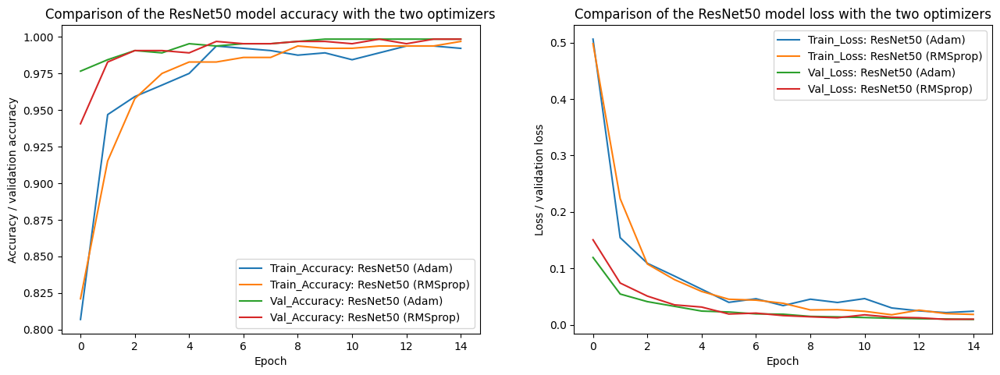

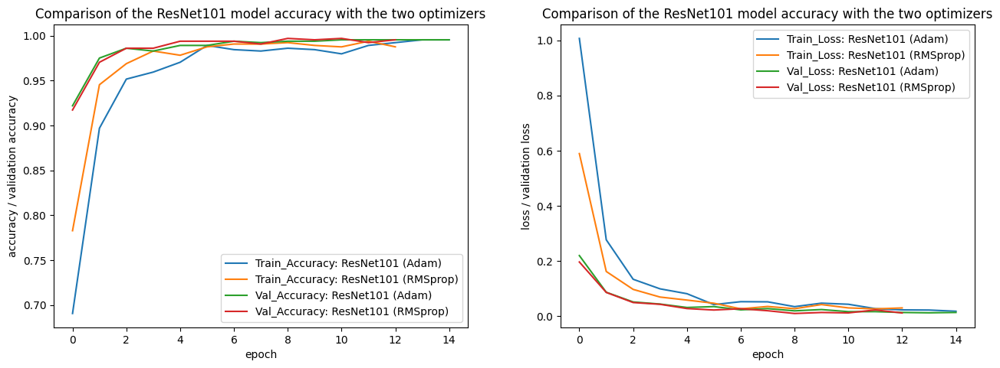

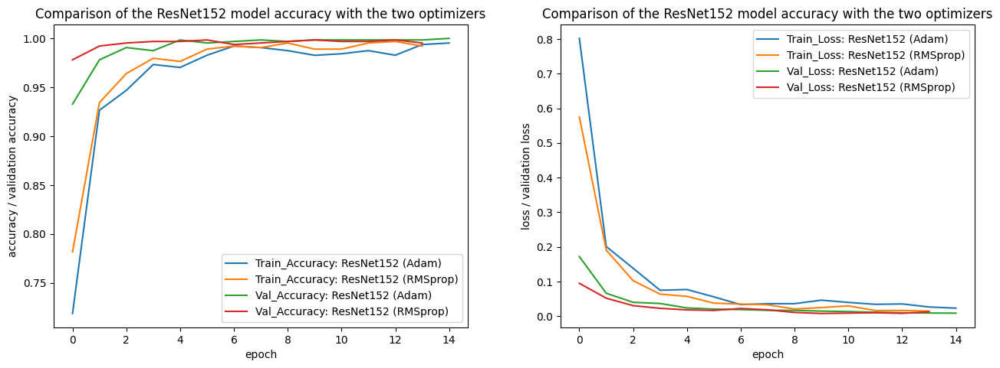

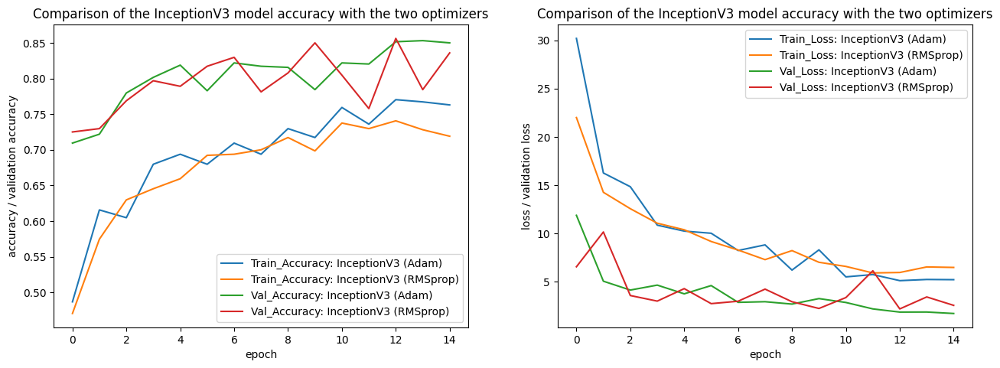

In [41]:
# Comparison of the Accuracy of the individual models with adam and with RMSprop optiomizer.

# ResNet50
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
plt.plot(history_ResNet50_adam.history['accuracy'], label="ResNet50 (optimizer: Adam)")
plt.plot(history_ResNet50_rmsprop.history['accuracy'], label="ResNet50 (optimizer: RMSprop)")
plt.plot(history_ResNet50_adam.history['val_accuracy'], label="ResNet50 (optimizer: Adam - Validation)")
plt.plot(history_ResNet50_rmsprop.history['val_accuracy'], label="ResNet50 (optimizer: RMSprop - Validation)")
plt.title('Comparison of the ResNet50 model accuracy with the two optimizers')
plt.ylabel('Accuracy / validation accuracy')
plt.xlabel('Epoch')
plt.legend(['Train_Accuracy: ResNet50 (Adam)', 'Train_Accuracy: ResNet50 (RMSprop)', 'Val_Accuracy: ResNet50 (Adam)', 'Val_Accuracy: ResNet50 (RMSprop)'],loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history_ResNet50_adam.history['loss'], label="ResNet50 (optimizer: Adam)")
plt.plot(history_ResNet50_rmsprop.history['loss'], label="ResNet50 (optimizer: RMSprop)")
plt.plot(history_ResNet50_adam.history['val_loss'], label="ResNet50 (optimizer: Adam - Validation)")
plt.plot(history_ResNet50_rmsprop.history['val_loss'], label="ResNet50 (optimizer: RMSprop - Validation)")
plt.title('Comparison of the ResNet50 model loss with the two optimizers')
plt.ylabel('Loss / validation loss')
plt.xlabel('Epoch')
plt.legend(['Train_Loss: ResNet50 (Adam)', 'Train_Loss: ResNet50 (RMSprop)', 'Val_Loss: ResNet50 (Adam)', 'Val_Loss: ResNet50 (RMSprop)'],loc='upper right')

plt.tight_layout(pad=5.0)
plt.show()

###################################################

# ResNet101
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
plt.plot(history_ResNet101_adam.history['accuracy'], label = "ResNet101 (optimizer: Adam)")
plt.plot(history_ResNet101_rmsprop.history['accuracy'], label = "ResNet101 (optimizer: RMSprop)")
plt.plot(history_ResNet101_adam.history['val_accuracy'], label = "ResNet101 (optimizer: Adam)")
plt.plot(history_ResNet101_rmsprop.history['val_accuracy'], label = "ResNet101 (optimizer: RMSprop)")
plt.title('Comparison of the ResNet101 model accuracy with the two optimizers')
plt.ylabel('accuracy / validation accuracy')
plt.xlabel('epoch')
plt.legend(['Train_Accuracy: ResNet101 (Adam)', 'Train_Accuracy: ResNet101 (RMSprop)', 'Val_Accuracy: ResNet101 (Adam)', 'Val_Accuracy: ResNet101 (RMSprop)'], loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history_ResNet101_adam.history['loss'], label = "ResNet101 (optimizer: Adam)")
plt.plot(history_ResNet101_rmsprop.history['loss'], label = "ResNet101 (optimizer: RMSprop)")
plt.plot(history_ResNet101_adam.history['val_loss'], label = "ResNet101 (optimizer: Adam)")
plt.plot(history_ResNet101_rmsprop.history['val_loss'], label = "ResNet101 (optimizer: RMSprop)")
plt.title('Comparison of the ResNet101 model accuracy with the two optimizers')
plt.ylabel('loss / validation loss')
plt.xlabel('epoch')
plt.legend(['Train_Loss: ResNet101 (Adam)', 'Train_Loss: ResNet101 (RMSprop)', 'Val_Loss: ResNet101 (Adam)', 'Val_Loss: ResNet101 (RMSprop)'],loc='upper right')
plt.tight_layout(pad=5.0)
plt.show()

###################################################

# ResNet152
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
plt.plot(history_ResNet152_adam.history['accuracy'], label = "ResNet152 (optimizer: Adam)")
plt.plot(history_ResNet152_rmsprop.history['accuracy'], label = "ResNet152 (optimizer: RMSprop)")
plt.plot(history_ResNet152_adam.history['val_accuracy'], label = "ResNet152 (optimizer: Adam)")
plt.plot(history_ResNet152_rmsprop.history['val_accuracy'], label = "ResNet152 (optimizer: RMSprop)")
plt.title('Comparison of the ResNet152 model accuracy with the two optimizers')
plt.ylabel('accuracy / validation accuracy')
plt.xlabel('epoch')
plt.legend(['Train_Accuracy: ResNet152 (Adam)', 'Train_Accuracy: ResNet152 (RMSprop)', 'Val_Accuracy: ResNet152 (Adam)', 'Val_Accuracy: ResNet152 (RMSprop)'], loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history_ResNet152_adam.history['loss'], label = "ResNet152 (optimizer: Adam)")
plt.plot(history_ResNet152_rmsprop.history['loss'], label = "ResNet152 (optimizer: RMSprop)")
plt.plot(history_ResNet152_adam.history['val_loss'], label = "ResNet152 (optimizer: Adam)")
plt.plot(history_ResNet152_rmsprop.history['val_loss'], label = "ResNet152 (optimizer: RMSprop)")
plt.title('Comparison of the ResNet152 model accuracy with the two optimizers')
plt.ylabel('loss / validation loss')
plt.xlabel('epoch')
plt.legend(['Train_Loss: ResNet152 (Adam)', 'Train_Loss: ResNet152 (RMSprop)', 'Val_Loss: ResNet152 (Adam)', 'Val_Loss: ResNet152 (RMSprop)'],loc='upper right')
plt.tight_layout(pad=5.0)
plt.show()

###################################################

# InceptionV3
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
plt.plot(history_InceptionV3_adam.history['accuracy'], label = "InceptionV3 (optimizer: Adam)")
plt.plot(history_InceptionV3_rmsprop.history['accuracy'], label = "InceptionV3 (optimizer: RMSprop)")
plt.plot(history_InceptionV3_adam.history['val_accuracy'], label = "InceptionV3 (optimizer: Adam)")
plt.plot(history_InceptionV3_rmsprop.history['val_accuracy'], label = "InceptionV3 (optimizer: RMSprop)")
plt.title('Comparison of the InceptionV3 model accuracy with the two optimizers')
plt.ylabel('accuracy / validation accuracy')
plt.xlabel('epoch')
plt.legend(['Train_Accuracy: InceptionV3 (Adam)', 'Train_Accuracy: InceptionV3 (RMSprop)', 'Val_Accuracy: InceptionV3 (Adam)', 'Val_Accuracy: InceptionV3 (RMSprop)'], loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history_InceptionV3_adam.history['loss'], label = "InceptionV3 (optimizer: Adam)")
plt.plot(history_InceptionV3_rmsprop.history['loss'], label = "InceptionV3 (optimizer: RMSprop)")
plt.plot(history_InceptionV3_adam.history['val_loss'], label = "InceptionV3 (optimizer: Adam)")
plt.plot(history_InceptionV3_rmsprop.history['val_loss'], label = "InceptionV3 (optimizer: RMSprop)")
plt.title('Comparison of the InceptionV3 model accuracy with the two optimizers')
plt.ylabel('loss / validation loss')
plt.xlabel('epoch')
plt.legend(['Train_Loss: InceptionV3 (Adam)', 'Train_Loss: InceptionV3 (RMSprop)', 'Val_Loss: InceptionV3 (Adam)', 'Val_Loss: InceptionV3 (RMSprop)'], loc='upper right')
plt.tight_layout(pad=5.0)
plt.show()

## Interpretation of the Accuracy and Loss
In the block above, the four models architectures are not directly compared with each other, but the respective model is compared with the two different optimizers. In order to get an overview which of the optimizers delivers a better result. For this purpose, the training accuracy and the validation accuacy of the respective models are displayed and compared in a plot. It should be mentioned that the validation accuracy is much more important for the comparison, but to get a feeling for the model it makes sense to look at the training accuracy as well. The second block for each model is the comparison of the trainings loss and the validation loss. Both plots are important to get an understanding of the model and to be able to make statements about the models.

## **Comparison of the two optimizers:**
In this section, the previously presented results are briefly discussed and explained. For this purpose, each model architecture is considered individually. A summary of the results is given at the end.

At the beginning you will notice that not all lines in the graph are the same length, this is not because there was a mistake, but because the training was stopped because of the early stopping criterion introduced earlier. Notably, the green and red lines, especially those representing the accuracies, play a pivotal role in comprehending the models' progression throughout the learning process. So that also with another training result is comprehensible about which graphs is spoken, in each case pictures are linked. They show the graphs to which the text below refers.



**ResNet50:**              
First, the performance of the ResNet50 model is analyzed.

- Upon observation of the figure, it becomes evident that the models using different optimizers exhibited minimal discrepancies. Although various fluctuations were observed during training, they were relatively small, resulting in nearly identical outcomes. RMSprop demonstrated a more stable accuracy, with fewer fluctuations compared to the Adam optimizer. This suggests that the weights were adjusted to a lesser extent in the RMSprop model.

- In terms of validation accuracy, the ResNet50 (Adam) model initially displayed better values. However, as training progressed, its performance declined, eventually being surpassed by the ResNet50 (RMSprop) model, which achieved better results. Both models, nevertheless, yielded highly satisfactory outcomes, approaching close to 100% accuracy.
- With respect to the trained epochs, it can be seen that the ResNet50 (RMSprop) was stopped somewhat earlier due to the early stopping procedure. This is done to avoid overfitting, early stopping monitors the performance of the model on a separate validation dataset during training. Training is stopped when performance on the validation dataset stops improving or even deteriorates. At this point, it is assumed that the model has reached the point where it can be best generalized and thus cannot be improved any further.

- Another good point is that the accuarcy and the valdiation accuarcy did not differ much. A small difference between the two metrics indicates that the model generalizes well and performs similarly well on unknown data as it does on training data.
- The loss as well as the validation loss of both models looks very good. The values have an almost permanent decrease, where there are only small fluctuations. Furthermore, the validation loss is as good as the loss, which indicates that the model has good generalization capabilities and is not overfitted. Similar good performance on the validation data compared to the training data indicates that the model is able to predict effectively on unknown data and is not just rote learning.
- (Notebook_images\ResNet50-accuracy-loss.PNG)


**ResNet101:**                
The next model is the ResNet101

- Like with the ResNet50, the models develop very well over the epochs. However, it is noticeable that the valdation accuracy of the model with adam optimizer delivers worse results than the training accuracy.
- In addition, the ResNet101 (RMSprop) model delivers slightly better results, even if the difference is not particularly large.
- It can already be seen that the ResNet101 gives slightly worse results than the ResNet50, since the graphs do not come as close to the 100% Accuarcy.
- It is also noticeable that this time the ResNet101 (Adam) model was aborted a bit earlier during training. Therefore, no pattern can be seen with the optimizers yet.  
- With the loss and the validation loss there is again only a small difference, which is good. However, there are more fluctuations during the training, but they subside again towards the end of the training. It should be mentioned that the fluctuation of the loss and the validation loss during the training can mean that the model has not yet converged stably and the training has not yet been completed. This should therefore not be underestimated.


- (Notebook_images\ResNet101-accuracy-loss.PNG)



**ResNet152:**                
- Also for the ResNet152 model, the development of accuracy and loss is very similar to the previous models.
- There is again an earlier stopping of the training in the model with adam optimizer. But results at the end are again almost the same as with the ResNet152 (RMSprop) model.
- The model delivers very good results and also the loss and the valuation loss deliver only little fluctuations and are very close to each other, which speaks for a well-generalized model.

- (Notebook_images\ResNet152-accuracy-loss.PNG)



**InceptionV3:**            
The last model is the InceptionV3
- The first major changes are seen in the InceptionV3 models. Here you can see that the inceptionV3 (Adam) model stops much earlier with the training. This model also delivers significantly better results than the model with RMSprop optimizer.
- It is also noticeable that the accuracy and the validation accuracy are significantly different. If the validation accuracy is significantly better than the training accuracy, this may indicate overfitting, erroneous data or problems with model complexity. To address this imbalance, measures such as reducing model complexity, applying regularization techniques, or improving training data quality should be considered. The goal is to obtain a model that performs well on both training data and new data and provides reliable predictions.
- Both models do not perform well, with accuracies ranging from about 70 to 90 percent. Compared to the other models, these are very poor results. This will also be noticeable when testing the models.  
- Possible reasons why the InceptionV3 models perform so poorly include random initialization of model weights, inappropriate model architecture, incorrectly chosen hyperparameters, susceptibility to overfitting, or faulty implementation.

## **Comparison of the four model architectures:**

In the following, the four model architectures are compared. These include ResNet50, ResNet101, ResNet152 and InceptionV3. For each architecture there are two models that are compared, one with Adam and the other with RMSprop optimizer.

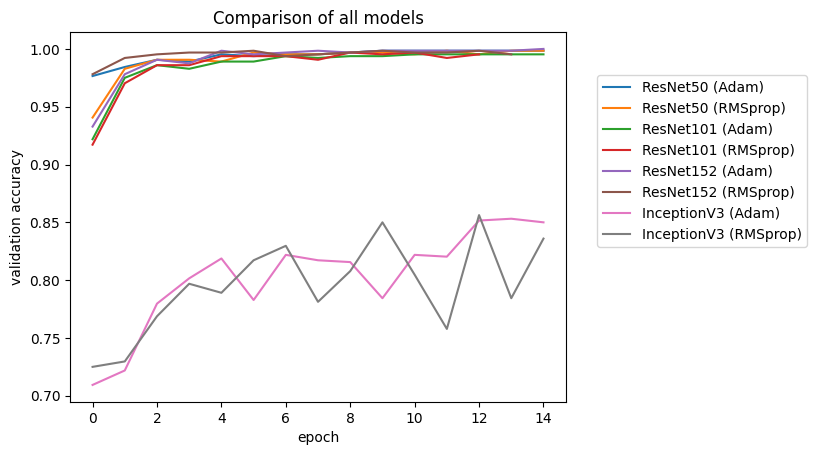

In [42]:
#  "Accuracy"
plt.plot(history_ResNet50_adam.history['val_accuracy'], label = "ResNet50 (optimizer: Adam)")
plt.plot(history_ResNet50_rmsprop.history['val_accuracy'], label = "ResNet50 (optimizer: RMSprop)")
plt.plot(history_ResNet101_adam.history['val_accuracy'], label = "ResNet101 (optimizer: Adam)")
plt.plot(history_ResNet101_rmsprop.history['val_accuracy'], label = "ResNet101 (optimizer: RMSprop)")
plt.plot(history_ResNet152_adam.history['val_accuracy'], label = "ResNet152 (optimizer: Adam)")
plt.plot(history_ResNet152_rmsprop.history['val_accuracy'], label = "ResNet152 (optimizer: RMSprop)")
plt.plot(history_InceptionV3_adam.history['val_accuracy'], label = "InceptionV3 (optimizer: Adam)")
plt.plot(history_InceptionV3_rmsprop.history['val_accuracy'], label = "InceptionV3 (optimizer: RMSprop)")
plt.title('Comparison of all models')
plt.ylabel('validation accuracy')
plt.xlabel('epoch')
plt.legend(['ResNet50 (Adam)', 'ResNet50 (RMSprop)', 'ResNet101 (Adam)', 'ResNet101 (RMSprop)', 'ResNet152 (Adam)', 'ResNet152 (RMSprop)', 'InceptionV3 (Adam)', 'InceptionV3 (RMSprop)'], loc='lower right', bbox_to_anchor=(1.5, 0.4))
plt.show()

## Compare all models with each other
As previously observed, most models exhibit very similar performance. There are only two significant outliers, which are the Inception models, as mentioned earlier.

The best-performing models in this scenario are those that use the RMSprop optimizer. However, no model stands out significantly, as the differences are minimal. In this run, the ResNet152 (RMSprop) and ResNet50 (RMSprop) achieved the highest accuracies on the validation dataset.

It should be noted that the results may vary slightly depending on the run, especially when the performance differences are so small.

# Testing
## Preparing test images

In the following block, the test images of the two classes are loaded from the directory. They are normalized and resized directly to have the same format as the other images. A label with "Tim" or "Unknown" is then created for the respective images. To bring some varraiation into the dataset the images are shuffled, the same happens with the labels so that they still fit to the images.

In [43]:
# Load and prepare the test images
test_path_tim = 'data/test/tim'
test_path_unknown = 'data/test/unknown'
test_path_objects = 'data/test/objects'

def getImages(test_image_folder):
    test_images = []
    for image_path in os.listdir(test_image_folder):
        image = Image.open(os.path.join(test_image_folder, image_path))
        temp_data = img_to_array(image)
        img_norm = cv2.normalize(temp_data, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
        if img_norm.ndim == 2:
          img_norm = np.expand_dims(img_norm, axis=-1)  # Add channel dimension if the image is grayscale

        image_norm = array_to_img(img_norm)

        image = image_norm.resize((224, 224))  # Adjust the image size according to your requirements
        image = np.array(image) # Normalize the image pixels to the range 0-1
        # Check if the image has the expected shape before appending
        if image.shape == (224, 224, 3):
            test_images.append(image)
        else:
            print(f"Skipping image {image_path} with unexpected shape: {image.shape}")

    # Convert the list of images to a Numpy array
    return np.array(test_images)

test_images_tim = getImages(test_path_tim)
test_images_unknown = getImages(test_path_unknown)
test_images_objects = getImages(test_path_objects)

test_labels_tim = np.array(['Tim'] * len(test_images_tim))
test_labels_unknown = np.array(['Unknown'] * len(test_images_unknown))
test_labels_objects = np.array(['Objects'] * len(test_images_objects))


all_test_labels = np.concatenate((test_labels_tim, test_labels_unknown, test_labels_objects))
all_test_images = np.concatenate((test_images_tim, test_images_unknown, test_images_objects))

# Get the indices for shuffling
indices = np.arange(len(all_test_labels))

# Shuffle the indices
np.random.shuffle(indices)

# Shuffle the arrays using the shuffled indices
shuffled_labels = all_test_labels[indices]
shuffled_images = all_test_images[indices]

Skipping image image_11.jpg with unexpected shape: (224, 224)
Skipping image image_50.jpg with unexpected shape: (224, 224)
Skipping image image_26.jpg with unexpected shape: (224, 224)


## Apply models to test data

Now that the test data is available, the models can be applied to the test data. For this purpose, the labels are converted to the one-hot encoded format. With the function evaluate() the models can be tested. The function returns the test_loss and the test_accuracy. The test_accuracy is particularly important, because it indicates how well the model performs on images that have never been seen before. This value should be as high as possible to get a good result. The results of this test are compared in the next block with the other values in a table.

In [44]:
# Convert labels to numerical values
label_encoder = LabelEncoder()
numerical_labels_dom = label_encoder.fit_transform(shuffled_labels)

# Convert numerical labels to one-hot encoded format
one_hot_labels_dom = to_categorical(numerical_labels_dom, num_classes=3)

# Evaluate the model on the test dataset
ResNet50_adam_test_loss, ResNet50_adam_test_accuracy = ResNet50_model_adam.evaluate(shuffled_images, one_hot_labels_dom, batch_size=16)
ResNet101_adam_test_loss, ResNet101_adam_test_accuracy = ResNet101_model_adam.evaluate(shuffled_images, one_hot_labels_dom, batch_size=16)
ResNet152_adam_test_loss, ResNet152_adam_test_accuracy = ResNet152_model_adam.evaluate(shuffled_images, one_hot_labels_dom, batch_size=16)
InceptionV3_adam_test_loss, InceptionV3_adam_test_accuracy = InceptionV3_model_adam.evaluate(shuffled_images, one_hot_labels_dom, batch_size=16)

ResNet50_rmsprop_test_loss, ResNet50_rmsprop_test_accuracy = ResNet50_model_rmsprop.evaluate(shuffled_images, one_hot_labels_dom, batch_size=16)
ResNet101_rmsprop_test_loss, ResNet101_rmsprop_test_accuracy = ResNet101_model_rmsprop.evaluate(shuffled_images, one_hot_labels_dom, batch_size=16)
ResNet152_rmsprop_test_loss, ResNet152_rmsprop_test_accuracy = ResNet152_model_rmsprop.evaluate(shuffled_images, one_hot_labels_dom, batch_size=16)
InceptionV3_rmsprop_test_loss, InceptionV3_rmsprop_test_accuracy = InceptionV3_model_rmsprop.evaluate(shuffled_images, one_hot_labels_dom, batch_size=16)


21/21 [==============================] - 2s 42ms/step - loss: 2.1931 - accuracy: 0.8746


## Comparison of the models based on the obtained values

In order to better display the collected values, a table is created below. For this, the last loss and accuracy value of the training is passed. Also the validation loss and the validation accuracy. In addition, the previously selected test loss and the test accuracy. However, the validation accuracy and especially the test accuracy are decisive here. The other values have only been taken over out of interest.

In [45]:
import pandas as pd

# Liste der Modellnamen
model_names = ['ResNet50', 'ResNet101', 'ResNet152', 'InceptionV3']

# Liste der Optimierer
optimizers = ['adam', 'rmsprop']

# Daten sammeln
data = []

# Funktion, um den letzten Wert einer Metrik für ein gegebenes Modell und Optimierer aus dem Trainingsverlauf zu erhalten
def get_last_metric_value(history, metric_name):
    last_epoch = len(history.history[metric_name]) - 1
    last_value = history.history[metric_name][last_epoch]
    return last_value

# Schleife über alle Modelle und Optimierer
for model_name in model_names:
    for optimizer in optimizers:
        # Erstellen Sie den passenden Schlüssel für den Zugriff auf den Trainingsverlauf
        history_key = f'history_{model_name}_{optimizer}'

        # Den letzten Loss-Wert ausgeben
        last_loss = get_last_metric_value(eval(history_key), 'loss')

        # Den letzten Validierung-Loss-Wert ausgeben
        last_val_loss = get_last_metric_value(eval(history_key), 'val_loss')

        # Den letzten Accuracy-Wert ausgeben
        last_accuracy = get_last_metric_value(eval(history_key), 'accuracy')

        # Den letzten Validierung-Accuracy-Wert ausgeben
        last_val_accuracy = get_last_metric_value(eval(history_key), 'val_accuracy')

        # Testverlust und Testgenauigkeit für jedes Modell abrufen
        test_loss_key = f'{model_name}_{optimizer}_test_loss'
        test_accuracy_key = f'{model_name}_{optimizer}_test_accuracy'

        # Daten für die Tabelle sammeln
        data.append([model_name, optimizer, last_loss, last_val_loss, eval(test_loss_key), last_accuracy, last_val_accuracy,
                     eval(test_accuracy_key)])

# Erstellen der DataFrame-Tabelle
df = pd.DataFrame(data, columns=['Model', 'Optimizer', 'Last Loss', 'Last Validation Loss', 'Test Loss', 'Last Accuracy', 'Last Validation Accuracy','Test Accuracy'])
# Tabellarische Darstellung
print(df)

         Model Optimizer  Last Loss  Last Validation Loss  Test Loss  \
0     ResNet50      adam   0.023943              0.009398   0.006181   
1     ResNet50   rmsprop   0.018332              0.009923   0.004479   
2    ResNet101      adam   0.018206              0.013815   0.011432   
3    ResNet101   rmsprop   0.030147              0.011951   0.010930   
4    ResNet152      adam   0.023016              0.008580   0.015939   
5    ResNet152   rmsprop   0.014390              0.012541   0.024888   
6  InceptionV3      adam   5.205193              1.701206   1.587298   
7  InceptionV3   rmsprop   6.472997              2.542184   2.193145   

   Last Accuracy  Last Validation Accuracy  Test Accuracy  
0       0.992151                  0.998438       1.000000  
1       0.996875                  0.998438       1.000000  
2       0.995313                  0.995313       0.996942  
3       0.987500                  0.995313       0.996942  
4       0.995313                  1.000000       0.

## **Analyzing the obtained values:**

In the previous charts, it was indeed possible to analyze how the model developed over different epochs. However, it is not straightforward to read precise data in the decimal places. Therefore, the actual values will be compared again here for a more accurate assessment.

All the ResNet models show a really good Test Accuracy of over 99% with both optimizers. The ResNet50 does even reach the 100% Test Accuracy. In comparison, the InceptionV3 model only achieve an accuracy of 87% and 89% on the test data. This is a also a good outcome but still 10% less than the ResNet architectures.

## Prediction of the models

In this chapter, the test dataset is again transferred to the models, but this time not only the numerical values are output, but the images with the actual labels. This makes it possible to see better how well the models actually performed.

To do this, first the predict() function is used which takes a dataset as input and the result is a matrix or numpy array containing the predictions of the model for each input image in the dataset. This procedure is performed for each model

In [46]:
# Get the Results of the models predicting the testing images
#ResNet50
predictions_tim_ResNet50_model_adam = ResNet50_model_adam.predict(test_images_tim)
predictions_tim_ResNet50_model_rmsprop = ResNet50_model_rmsprop.predict(test_images_tim)

predictions_unknown_ResNet50_model_adam = ResNet50_model_adam.predict(test_images_unknown)
predictions_unknown_ResNet50_model_rmsprop = ResNet50_model_rmsprop.predict(test_images_unknown)

predictions_objects_ResNet50_model_adam = ResNet50_model_adam.predict(test_images_objects)
predictions_objects_ResNet50_model_rmsprop = ResNet50_model_rmsprop.predict(test_images_objects)

#ResNet101
predictions_tim_ResNet101_model_adam = ResNet101_model_adam.predict(test_images_tim)
predictions_tim_ResNet101_model_rmsprop = ResNet101_model_rmsprop.predict(test_images_tim)

predictions_unknown_ResNet101_model_adam = ResNet101_model_adam.predict(test_images_unknown)
predictions_unknown_ResNet101_model_rmsprop = ResNet101_model_rmsprop.predict(test_images_unknown)

predictions_objects_ResNet101_model_adam = ResNet101_model_adam.predict(test_images_objects)
predictions_objects_ResNet101_model_rmsprop = ResNet101_model_rmsprop.predict(test_images_objects)

#ResNet152
predictions_tim_ResNet152_model_adam = ResNet152_model_adam.predict(test_images_tim)
predictions_tim_ResNet152_model_rmsprop = ResNet152_model_rmsprop.predict(test_images_tim)

predictions_unknown_ResNet152_model__adam = ResNet152_model_adam.predict(test_images_unknown)
predictions_unknown_ResNet152_model_rmsprop = ResNet152_model_rmsprop.predict(test_images_unknown)

predictions_objects_ResNet152_model__adam = ResNet152_model_adam.predict(test_images_objects)
predictions_objects_ResNet152_model_rmsprop = ResNet152_model_rmsprop.predict(test_images_objects)

#Inception V3
predictions_tim_InceptionV3_model_adam = InceptionV3_model_adam.predict(test_images_tim)
predictions_tim_InceptionV3_model_rmsprop = InceptionV3_model_rmsprop.predict(test_images_tim)

predictions_unknown_InceptionV3_model_adam = InceptionV3_model_adam.predict(test_images_unknown)
predictions_unknown_InceptionV3_model_rmsprop = InceptionV3_model_rmsprop.predict(test_images_unknown)

predictions_objects_InceptionV3_model_adam = InceptionV3_model_adam.predict(test_images_objects)
predictions_objects_InceptionV3_model_rmsprop = InceptionV3_model_rmsprop.predict(test_images_objects)

3/3 [==============================] - 0s 61ms/step


In the next step, the previously determined predictions are determined with a selectively created function. Since the predictions are specified in numerical values, it is not so clear which class actually belongs to the label. Therefore we look in the function which class has the higher probability, the class with the higher probability is then assigned to the image.

In [47]:
# Function to get labels from predictions
def getLabel_from_prediction(predicitons):
    labels = []
    for i in range(len(predicitons)):
        if predicitons[i][0] > predicitons[i][1] and predicitons[i][0] > predicitons[i][2]:
            labels.append("Object")
        elif predicitons[i][1] > predicitons[i][0] and predicitons[i][1] > predicitons[i][2]:
            labels.append("Tim")
        else:
            labels.append("Unknown")
    return labels

#ResNet50
labels_tim_ResNet50_adam = getLabel_from_prediction(predictions_tim_ResNet50_model_adam)
labels_tim_ResNet50_rmsprop = getLabel_from_prediction(predictions_tim_ResNet50_model_rmsprop)

labels_unknown_ResNet50_adam = getLabel_from_prediction(predictions_unknown_ResNet50_model_adam)
labels_unknown_ResNet50_rmsprop = getLabel_from_prediction(predictions_unknown_ResNet50_model_rmsprop)

labels_objects_ResNet50_adam = getLabel_from_prediction(predictions_objects_ResNet50_model_adam)
labels_objects_ResNet50_rmsprop = getLabel_from_prediction(predictions_objects_ResNet50_model_rmsprop)

#ResNet101
labels_tim_ResNet101_adam = getLabel_from_prediction(predictions_tim_ResNet101_model_adam)
labels_tim_ResNet101_rmsprop = getLabel_from_prediction(predictions_tim_ResNet101_model_rmsprop)

labels_unknown_ResNet101_adam = getLabel_from_prediction(predictions_unknown_ResNet101_model_adam)
labels_unknown_ResNet101_rmsprop = getLabel_from_prediction(predictions_unknown_ResNet101_model_rmsprop)

labels_objects_ResNet101_adam = getLabel_from_prediction(predictions_objects_ResNet101_model_adam)
labels_objects_ResNet101_rmsprop = getLabel_from_prediction(predictions_objects_ResNet101_model_rmsprop)

#ResNet152
labels_tim_ResNet152_adam = getLabel_from_prediction(predictions_tim_ResNet152_model_adam)
labels_tim_ResNet152_rmsprop = getLabel_from_prediction(predictions_tim_ResNet152_model_rmsprop)

labels_unknown_ResNet152_adam = getLabel_from_prediction(predictions_unknown_ResNet152_model__adam)
labels_unknown_ResNet152_rmsprop = getLabel_from_prediction(predictions_unknown_ResNet152_model_rmsprop)

labels_objects_ResNet152_adam = getLabel_from_prediction(predictions_objects_ResNet152_model__adam)
labels_objects_ResNet152_rmsprop = getLabel_from_prediction(predictions_objects_ResNet152_model_rmsprop)

#Inception V3
labels_tim_InceptionV3_adam = getLabel_from_prediction(predictions_tim_InceptionV3_model_adam)
labels_tim_InceptionV3_rmsprop = getLabel_from_prediction(predictions_tim_InceptionV3_model_rmsprop)

labels_unknown_InceptionV3_adam = getLabel_from_prediction(predictions_unknown_InceptionV3_model_adam)
labels_unknown_InceptionV3_rmsprop = getLabel_from_prediction(predictions_unknown_InceptionV3_model_rmsprop)

labels_objects_InceptionV3_adam = getLabel_from_prediction(predictions_objects_InceptionV3_model_adam)
labels_objects_InceptionV3_rmsprop = getLabel_from_prediction(predictions_objects_InceptionV3_model_rmsprop)

## Plot testing results of the 'Tim' class
In the following section, the images from the test dataset are displayed. In addition, the labels created by the respective models for the individual images are also displayed. This makes it possible to see when a model has incorrectly labeled an image.

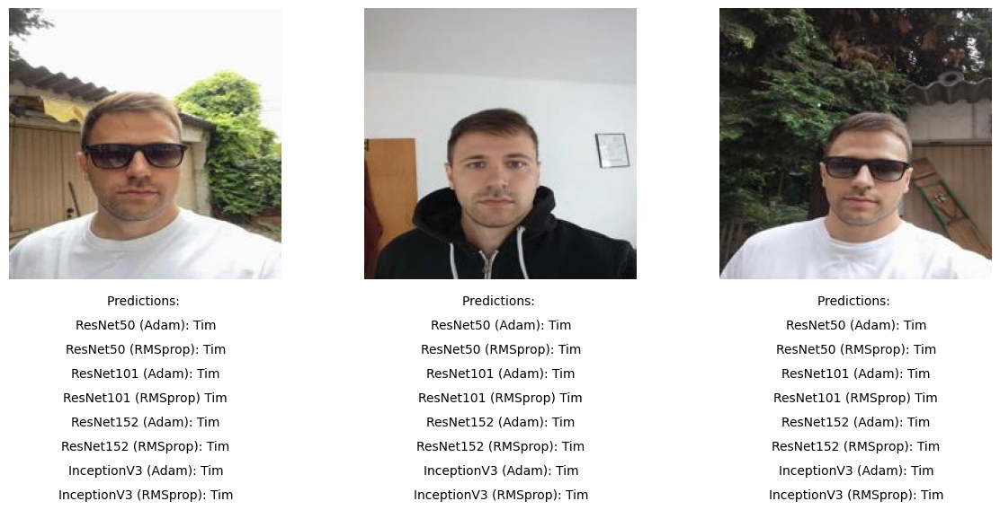

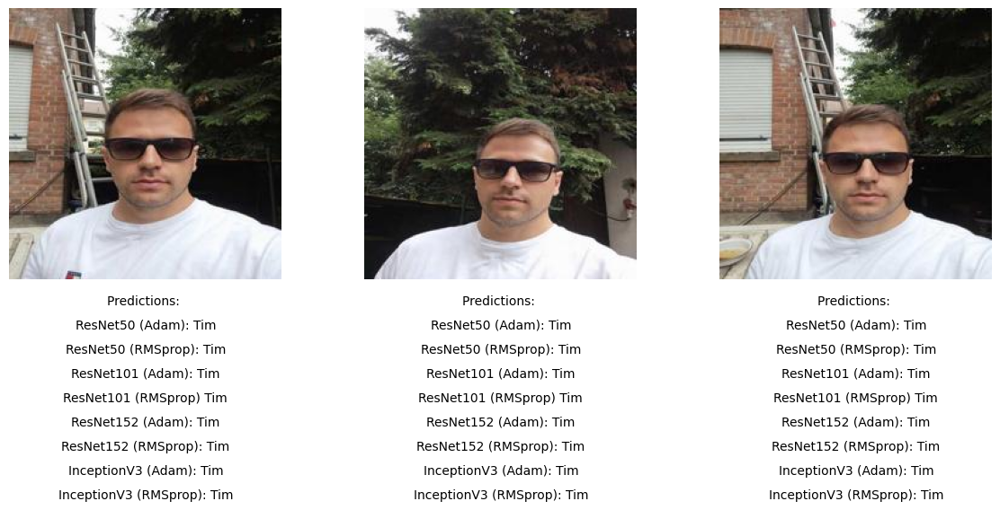

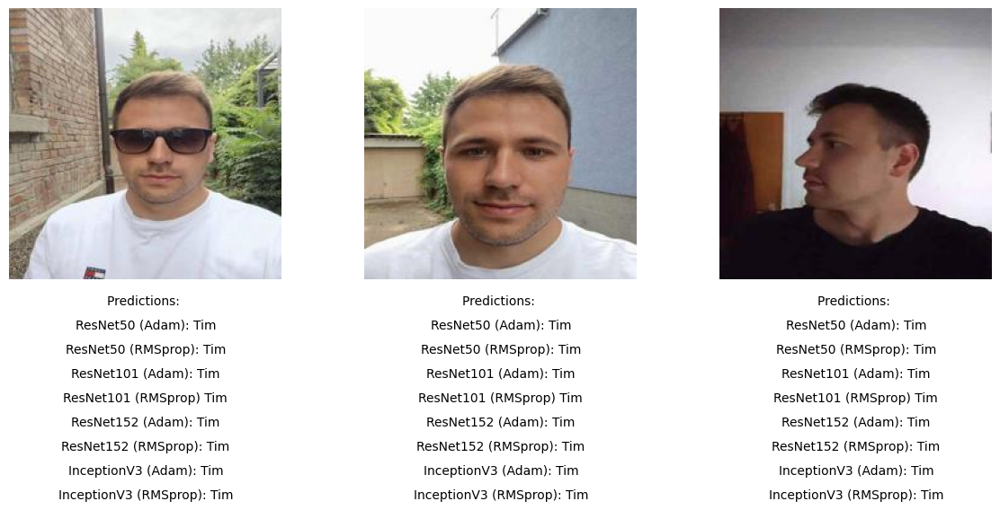

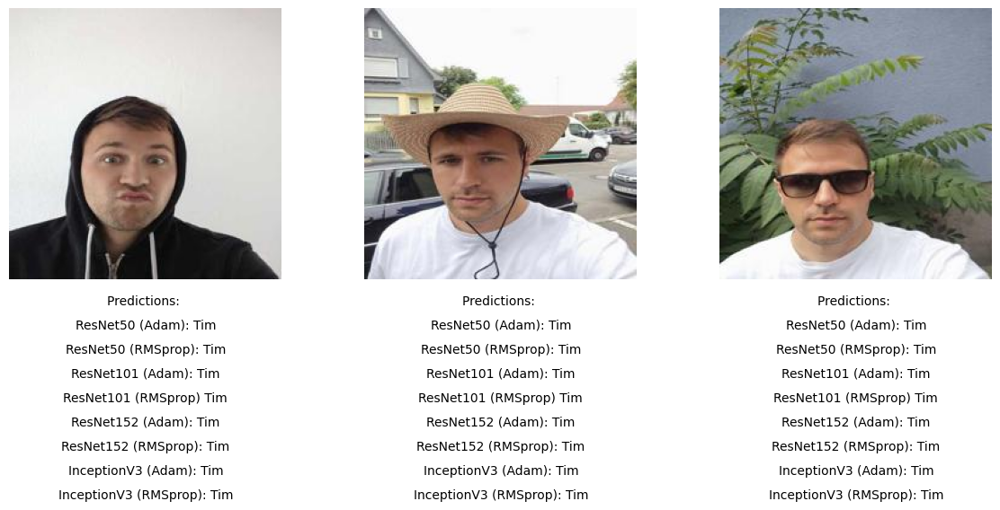

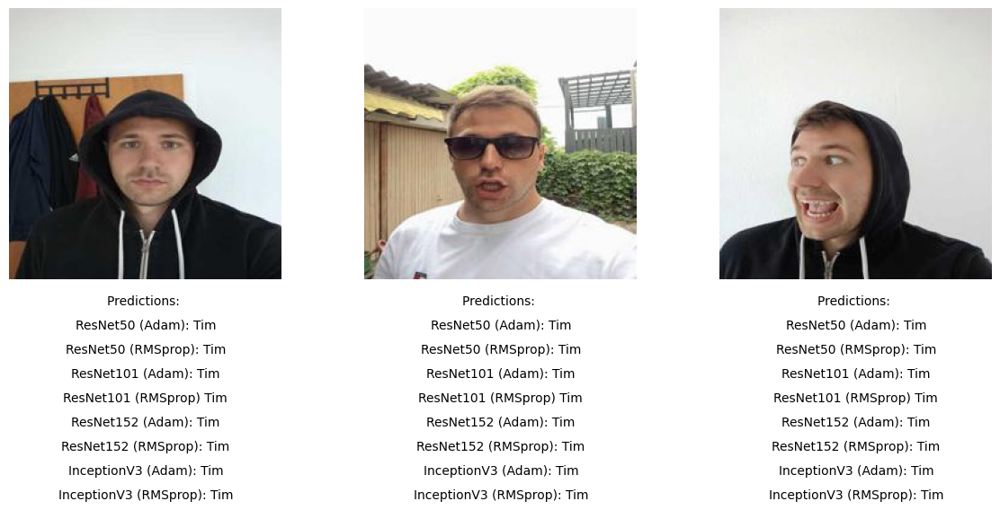

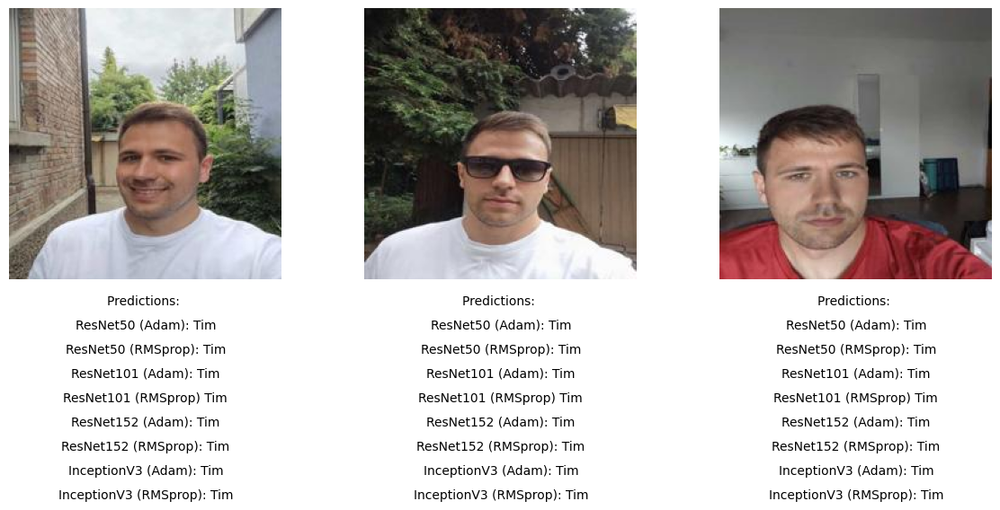

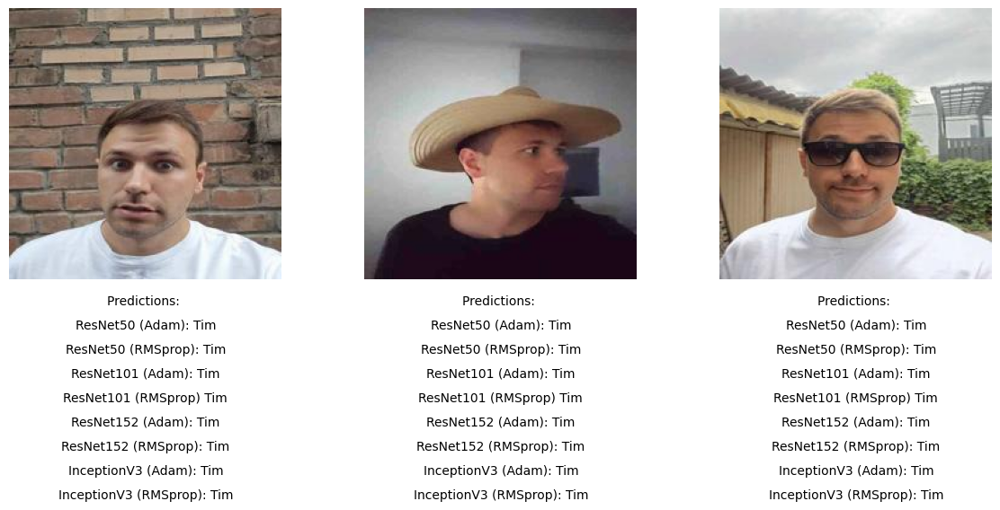

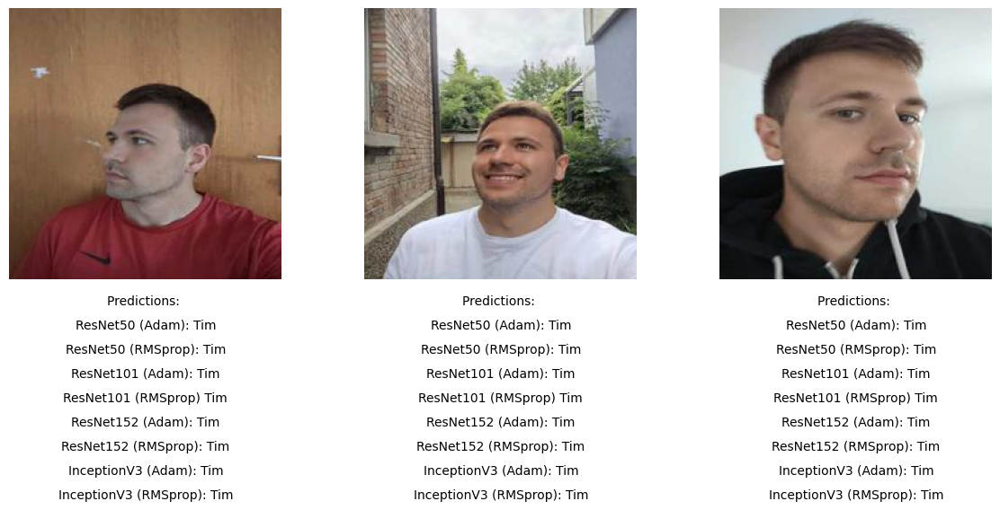

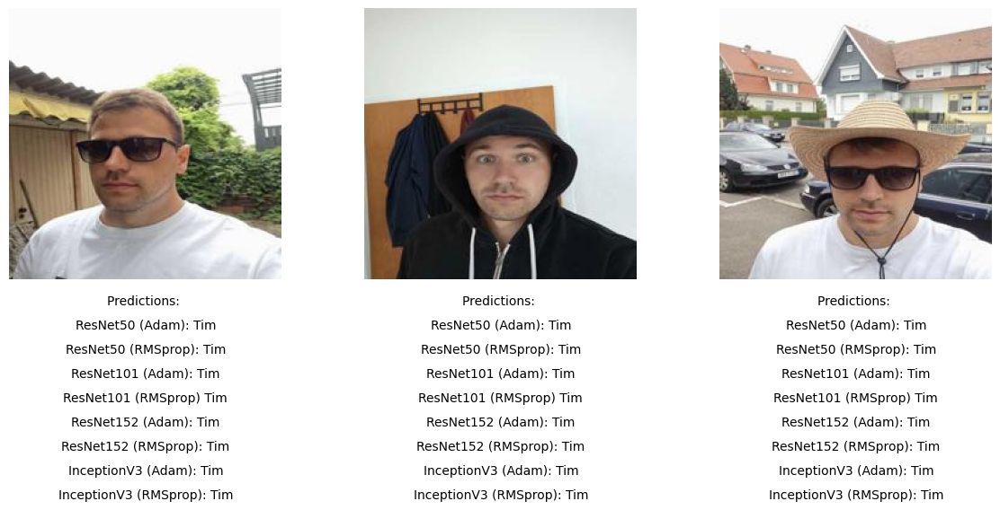

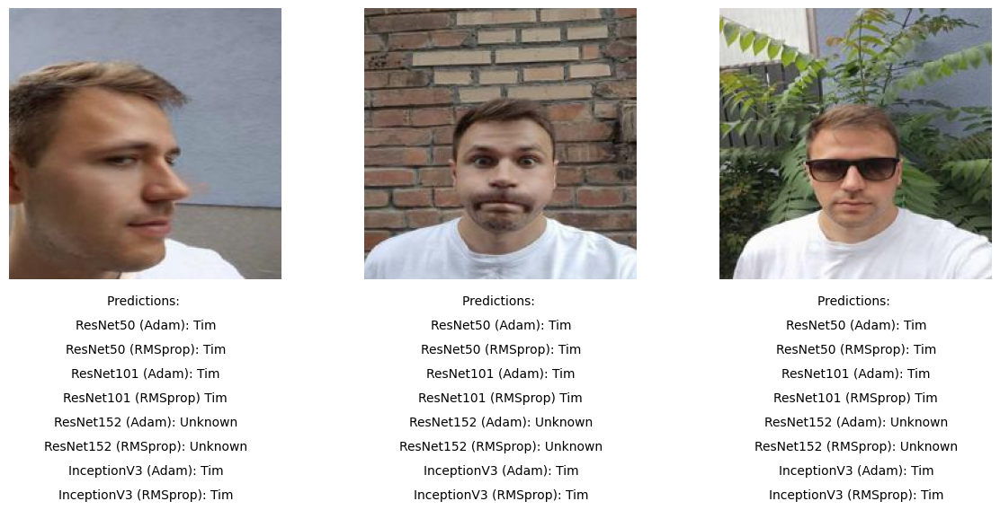

In [48]:
images_tim = []
for i in range(len(test_images_tim)):
    image = array_to_img(test_images_tim[i])
    images_tim.append(image)


for i in range(0, 30,3):
    # Create a figure and axes
    fig, ax = plt.subplots(1,3, figsize=(12, 5))

    # Display the image
    ax[0].imshow(images_tim[i])
    ax[1].imshow(images_tim[i+1])
    ax[2].imshow(images_tim[i+2])

    # Add a legend
    legend_text = ""
    ax[0].text(10, 10, legend_text, color='white', backgroundcolor='black')
    ax[1].text(10, 10, legend_text, color='white', backgroundcolor='black')
    ax[2].text(10, 10, legend_text, color='white', backgroundcolor='black')

    # predictions

    text_ResNet50_adam = "ResNet50 (Adam): " + labels_tim_ResNet50_adam[i]
    text_ResNet50_rmsprop = "ResNet50 (RMSprop): " + labels_tim_ResNet50_rmsprop[i]
    text_ResNet101_adam = "ResNet101 (Adam): " + labels_tim_ResNet101_adam[i]
    text_ResNet101_rmsprop = "ResNet101 (RMSprop) " + labels_tim_ResNet101_rmsprop[i]
    text_ResNet152_adam = "ResNet152 (Adam): " + labels_tim_ResNet152_adam[i]
    text_ResNet152_rmsprop = "ResNet152 (RMSprop): " + labels_tim_ResNet152_rmsprop[i]
    text_InceptionV3_adam = "InceptionV3 (Adam): " + labels_tim_InceptionV3_adam[i]
    text_InceptionV3_rmsprop = "InceptionV3 (RMSprop): " + labels_tim_InceptionV3_rmsprop[i]


    # Add text under the image
    text_lines = ["Predictions: ", text_ResNet50_adam, text_ResNet50_rmsprop, text_ResNet101_adam, text_ResNet101_rmsprop, text_ResNet152_adam, text_ResNet152_rmsprop, text_InceptionV3_adam, text_InceptionV3_rmsprop]
    text_position = (image.width // 2, image.height + 20)
    for line in text_lines:
        ax[0].text(*text_position, line, color='black', ha='center')
        ax[1].text(*text_position, line, color='black', ha='center')
        ax[2].text(*text_position, line, color='black', ha='center')
        text_position = (text_position[0], text_position[1] + 20)


    # Remove the axis labels
    ax[0].axis("off")
    ax[1].axis("off")
    ax[2].axis("off")

    # Adjust the layout
    plt.tight_layout()
    plt.show()

## Plot Test results of 'Unknown' class

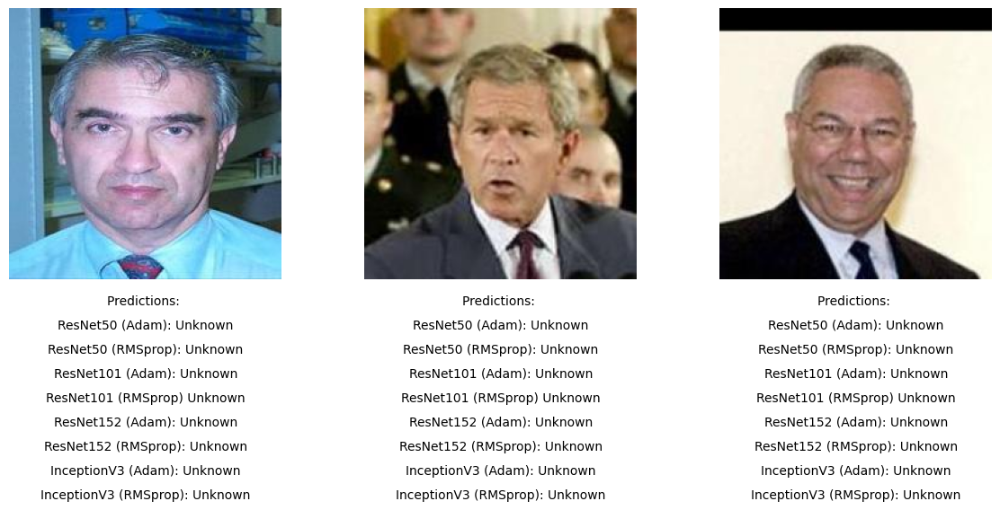

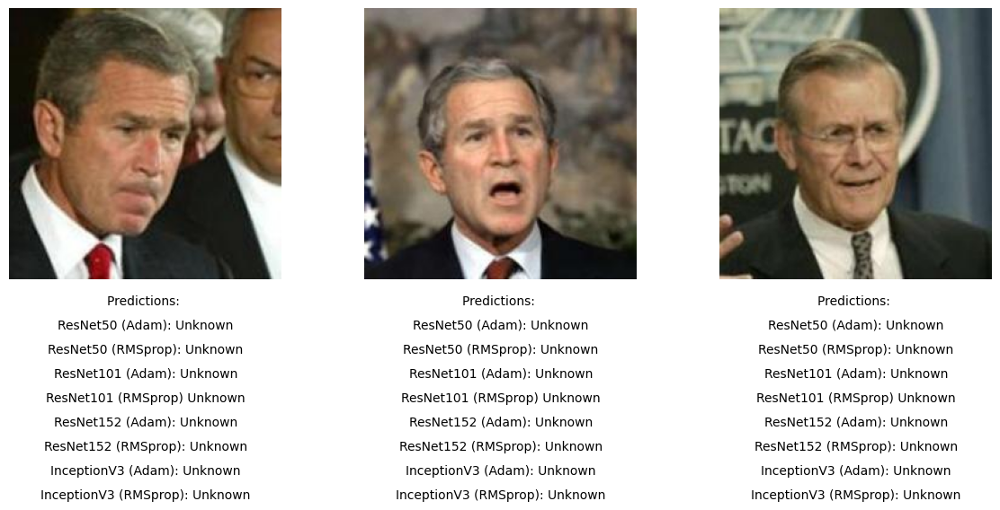

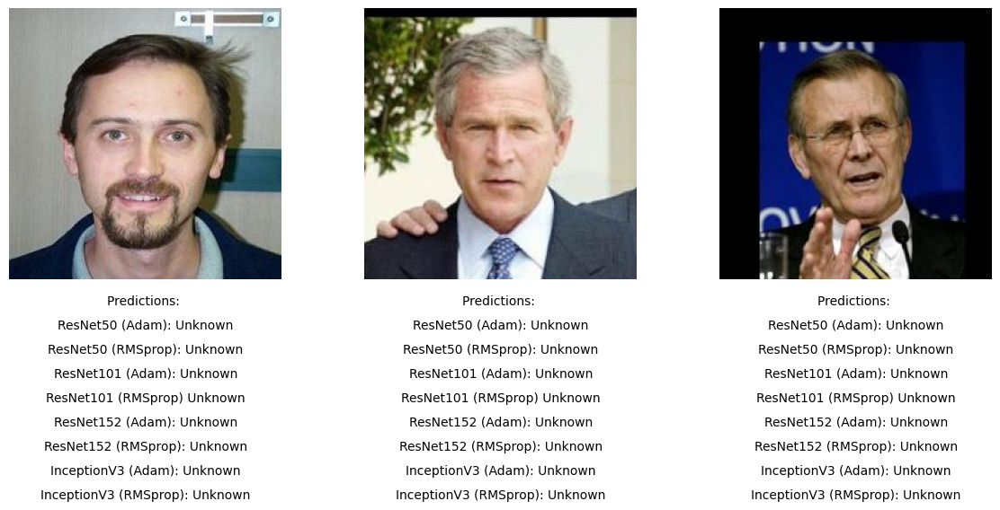

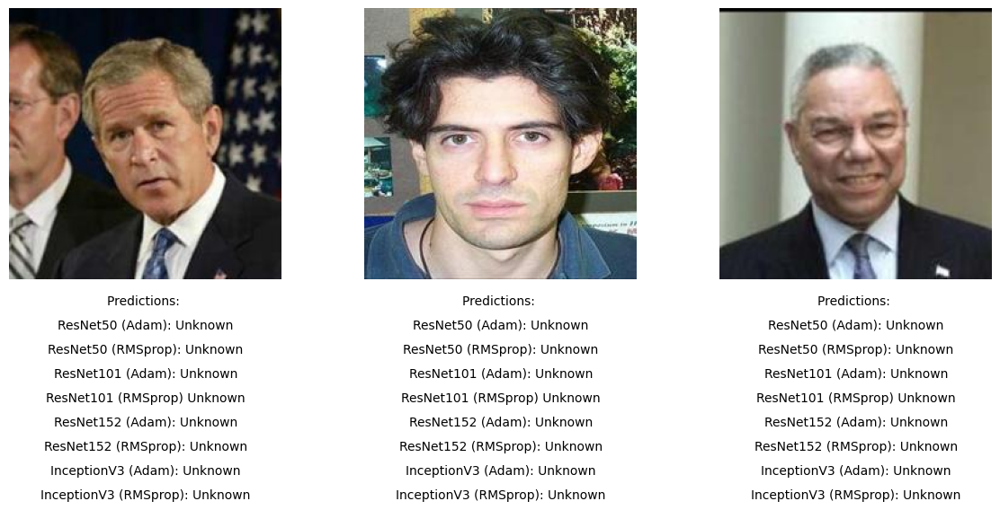

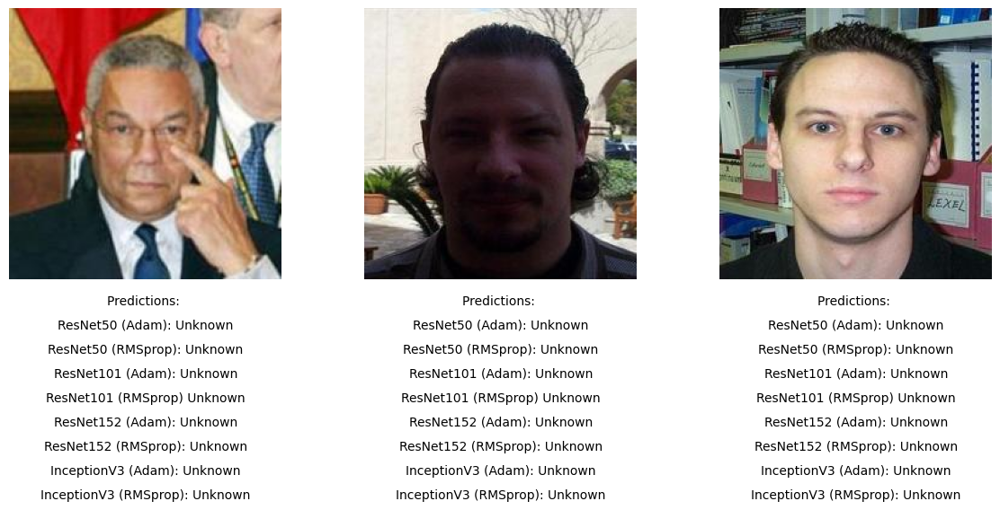

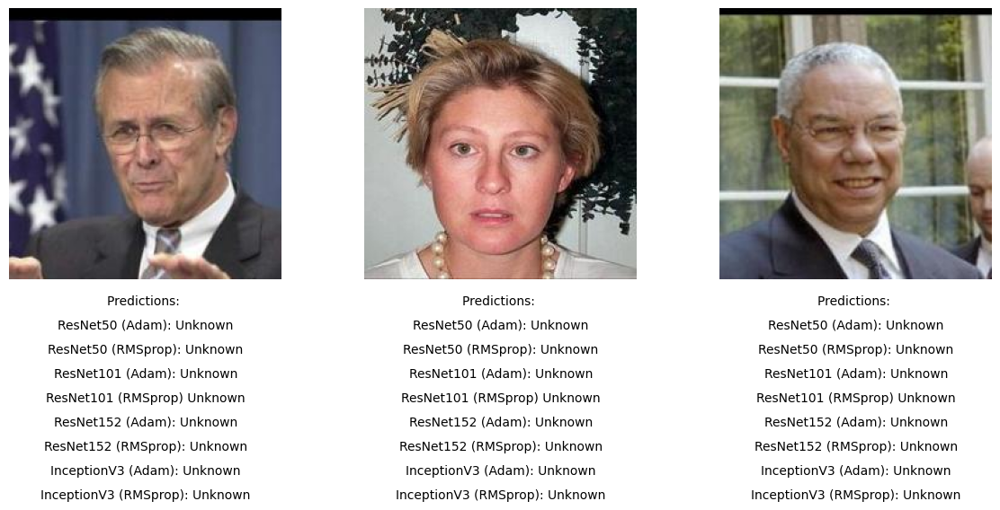

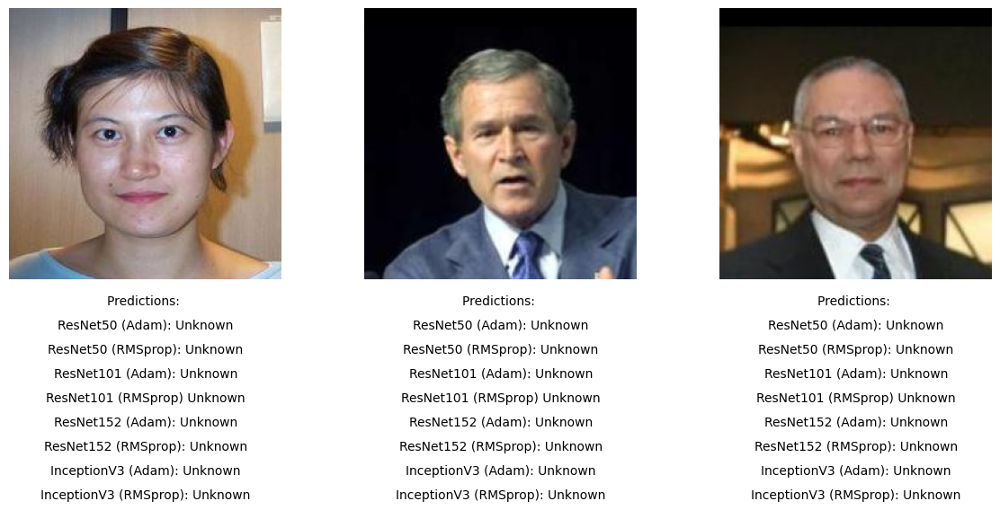

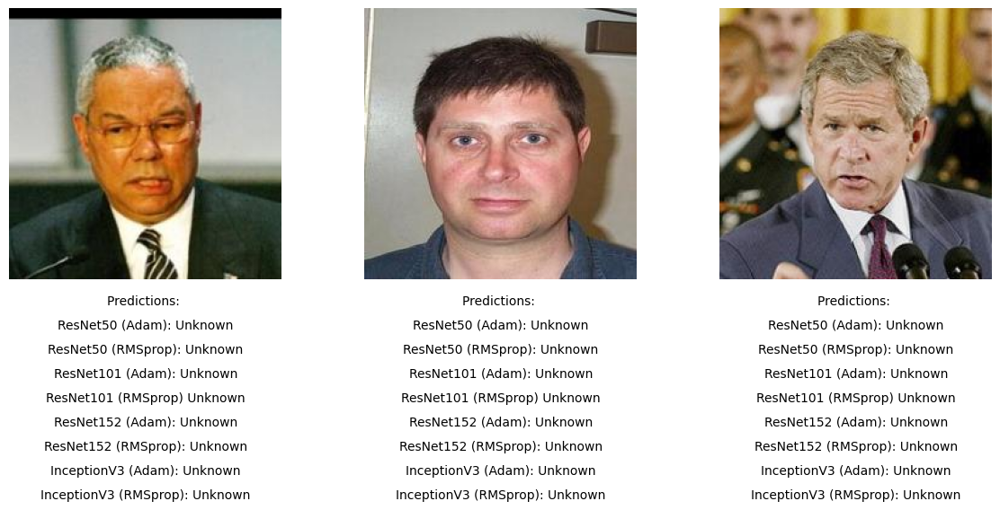

In [49]:
images_unknown = []
for i in range(len(test_images_unknown)):
    image = array_to_img(test_images_unknown[i])
    images_unknown.append(image)


for i in range(0, 24,3):
    # Create a figure and axes
    fig, ax = plt.subplots(1,3, figsize=(12, 5))

    # Display the image
    ax[0].imshow(images_unknown[i])
    ax[1].imshow(images_unknown[i+1])
    ax[2].imshow(images_unknown[i+2])

    # Add a legend
    legend_text = ""
    ax[0].text(10, 10, legend_text, color='white', backgroundcolor='black')
    ax[1].text(10, 10, legend_text, color='white', backgroundcolor='black')
    ax[2].text(10, 10, legend_text, color='white', backgroundcolor='black')

    # predictions
   # predictions
    text_ResNet50_adam = "ResNet50 (Adam): " + labels_unknown_ResNet50_adam[i]
    text_ResNet50_rmsprop = "ResNet50 (RMSprop): " + labels_unknown_ResNet50_rmsprop[i]
    text_ResNet101_adam = "ResNet101 (Adam): " + labels_unknown_ResNet101_adam[i]
    text_ResNet101_rmsprop = "ResNet101 (RMSprop) " + labels_unknown_ResNet101_rmsprop[i]
    text_ResNet152_adam = "ResNet152 (Adam): " + labels_unknown_ResNet152_adam[i]
    text_ResNet152_rmsprop = "ResNet152 (RMSprop): " + labels_unknown_ResNet152_rmsprop[i]
    text_InceptionV3_adam = "InceptionV3 (Adam): " + labels_unknown_InceptionV3_adam[i]
    text_InceptionV3_rmsprop = "InceptionV3 (RMSprop): " + labels_unknown_InceptionV3_rmsprop[i]


    # Add text under the image
    text_lines = ["Predictions: ", text_ResNet50_adam, text_ResNet50_rmsprop, text_ResNet101_adam, text_ResNet101_rmsprop, text_ResNet152_adam, text_ResNet152_rmsprop, text_InceptionV3_adam, text_InceptionV3_rmsprop]
    text_position = (image.width // 2, image.height + 20)
    for line in text_lines:
        ax[0].text(*text_position, line, color='black', ha='center')
        ax[1].text(*text_position, line, color='black', ha='center')
        ax[2].text(*text_position, line, color='black', ha='center')
        text_position = (text_position[0], text_position[1] + 20)


    # Remove the axis labels
    ax[0].axis("off")
    ax[1].axis("off")
    ax[2].axis("off")

    # Adjust the layout
    plt.tight_layout()

    # Show the plot
    plt.show()

## Plot Test results of 'Object' class

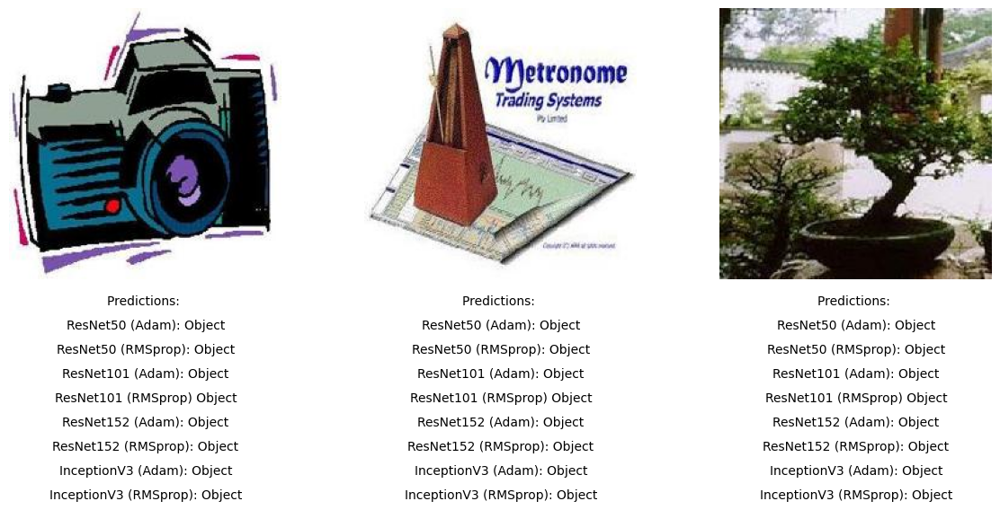

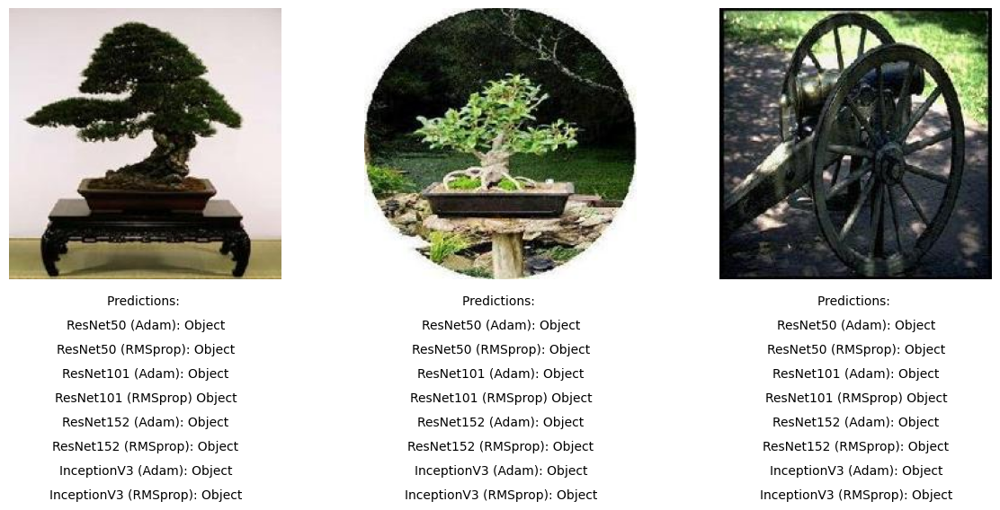

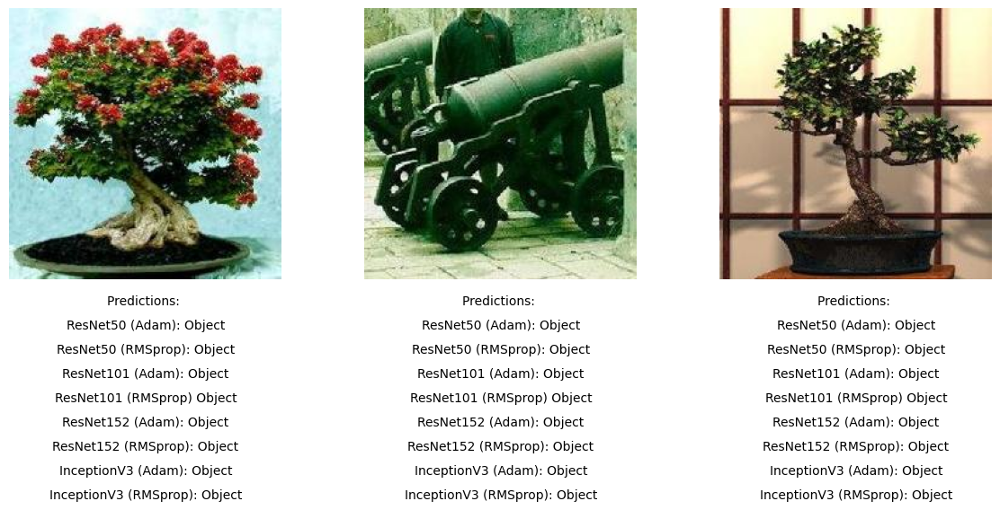

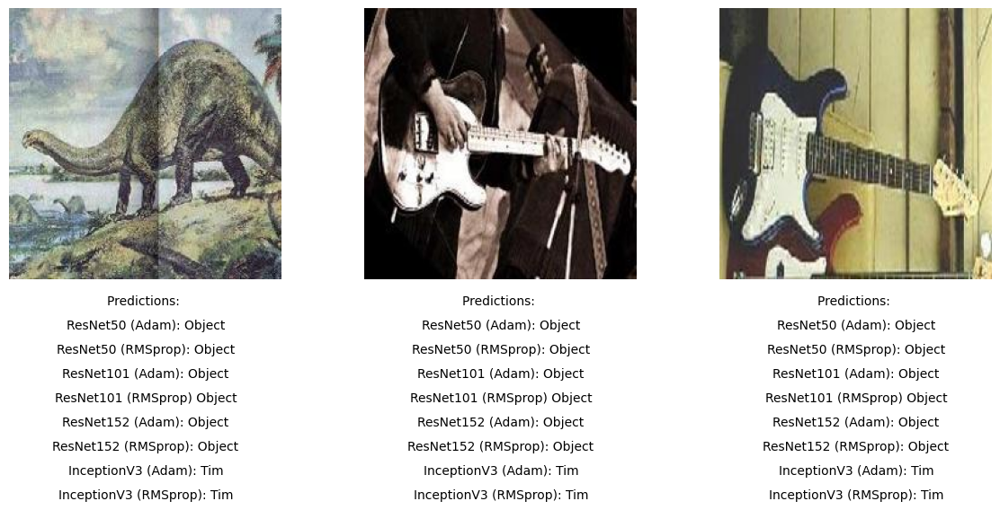

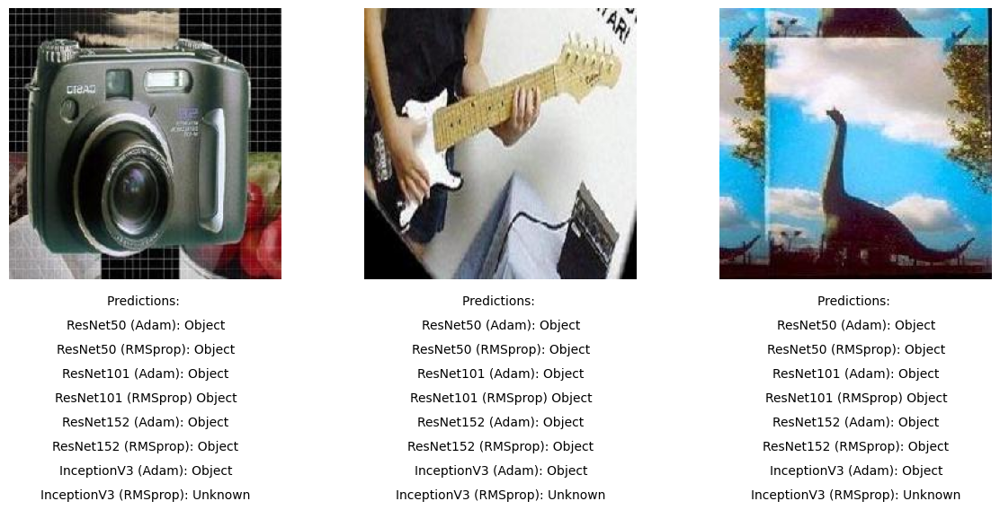

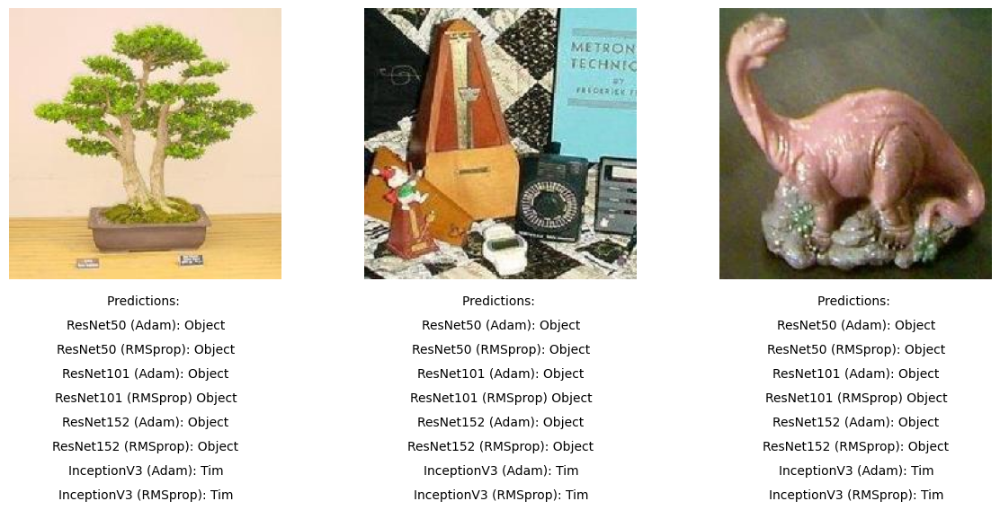

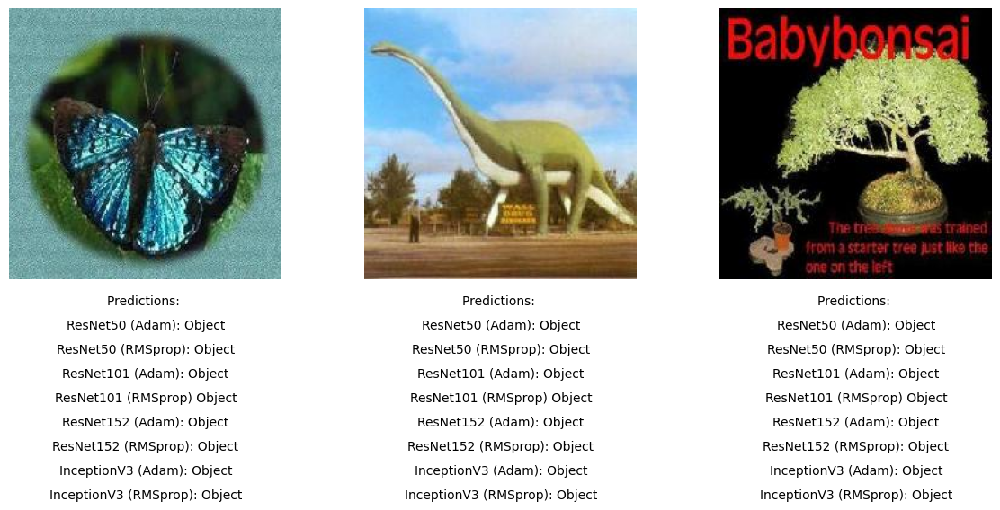

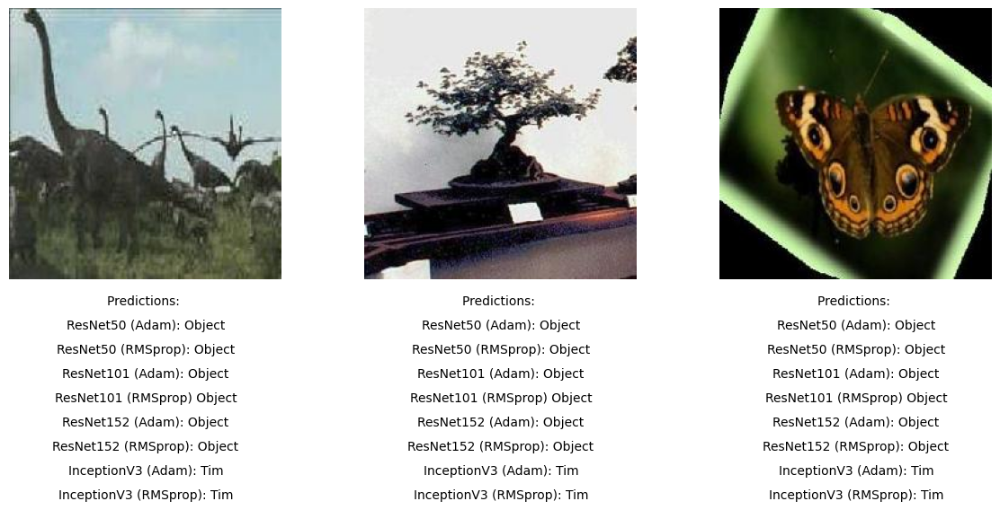

In [50]:
images_objects = []
for i in range(len(test_images_objects)):
    image = array_to_img(test_images_objects[i])
    images_objects.append(image)


for i in range(0, 24,3):
    # Create a figure and axes
    fig, ax = plt.subplots(1,3, figsize=(12, 5))

    # Display the image
    ax[0].imshow(images_objects[i])
    ax[1].imshow(images_objects[i+1])
    ax[2].imshow(images_objects[i+2])

    # Add a legend
    legend_text = ""
    ax[0].text(10, 10, legend_text, color='white', backgroundcolor='black')
    ax[1].text(10, 10, legend_text, color='white', backgroundcolor='black')
    ax[2].text(10, 10, legend_text, color='white', backgroundcolor='black')

    # predictions
   # predictions
    text_ResNet50_adam = "ResNet50 (Adam): " + labels_objects_ResNet50_adam[i]
    text_ResNet50_rmsprop = "ResNet50 (RMSprop): " + labels_objects_ResNet50_rmsprop[i]
    text_ResNet101_adam = "ResNet101 (Adam): " + labels_objects_ResNet101_adam[i]
    text_ResNet101_rmsprop = "ResNet101 (RMSprop) " + labels_objects_ResNet101_rmsprop[i]
    text_ResNet152_adam = "ResNet152 (Adam): " + labels_objects_ResNet152_adam[i]
    text_ResNet152_rmsprop = "ResNet152 (RMSprop): " + labels_objects_ResNet152_rmsprop[i]
    text_InceptionV3_adam = "InceptionV3 (Adam): " + labels_objects_InceptionV3_adam[i]
    text_InceptionV3_rmsprop = "InceptionV3 (RMSprop): " + labels_objects_InceptionV3_rmsprop[i]


    # Add text under the image
    text_lines = ["Predictions: ", text_ResNet50_adam, text_ResNet50_rmsprop, text_ResNet101_adam, text_ResNet101_rmsprop, text_ResNet152_adam, text_ResNet152_rmsprop, text_InceptionV3_adam, text_InceptionV3_rmsprop]
    text_position = (image.width // 2, image.height + 20)
    for line in text_lines:
        ax[0].text(*text_position, line, color='black', ha='center')
        ax[1].text(*text_position, line, color='black', ha='center')
        ax[2].text(*text_position, line, color='black', ha='center')
        text_position = (text_position[0], text_position[1] + 20)


    # Remove the axis labels
    ax[0].axis("off")
    ax[1].axis("off")
    ax[2].axis("off")

    # Adjust the layout
    plt.tight_layout()

    # Show the plot
    plt.show()

#Evaluation
## Evaluation of the test results on the test dataset

Based on the concrete example provided, it can now be confidently stated that the six ResNet models perform exceptionally well. They demonstrate almost perfect performance, with only one or two mislabeled images observed for the ResNet152 models. This indicates their high accuracy and reliability in predicting labels.

On the other hand, the Inception models shows a omparable result on the testing data as the ResNet152 with some miss labeling of the pictures, mostly struggeling with the objects.

Considering this, the ResNet's architectures perform better overall to detect faces although the optimizers seem to be very similar.

## Discussion of the results <a id="Conclusion"></a>

After evaluating the models, let's discuss the results briefly. The remarkable performance of the ResNet50 model is truly impressive, and it appears that the combination of Dropout, Early Stopping, and Data Augmentation has proven to be highly effective. But also the other models are showing very good results. Under the fact we only added one dense layer to the networks architectures, they really proven their robustness and that they can be used perfectly for transfer learning even though we had a rather small dataset to work with.

Evaluating these different models has provided valuable insights into the most effective techniques and architectures for this specific application. It highlights the significance of continually optimizing models to enhance their performance and achieve better results in the future.

In the beginning, two optimizers were defined for comparison since it was challenging to decide which one to use. However, it turned out to be unnecessary as the models performed almost identically, regardless of the chosen optimizer. The differences in performance between the two optimizers are so minimal that both can be confidently used for these models. This suggests that the model architecture and other hyperparameters have a more significant impact on performance than the optimizer choice. As a result, either optimizer can be employed with confidence for these specific models.